Copyright (c) 2020 Ryan Cohn and Elizabeth Holm. All rights reserved. <br />
Licensed under the MIT License (see LICENSE for details) <br />
Written by Ryan Cohn

# Instance Segmentation of Powder Particles and Satellites

This example will take you through the process of training a model to segment powder particles and visualizing the model predictions.

In [1]:
## regular module imports
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path
import pickle
import skimage.io
import sys

## detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import (
    DatasetCatalog,
    MetadataCatalog,
)
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.structures import BoxMode

## ampis
ampis_root = Path('../../')
sys.path.append(str(ampis_root))

from ampis import data_utils, visualize

%matplotlib inline

# Labeling Data

The [VGG Image Annotator](http://www.robots.ox.ac.uk/~vgg/software/via/) was used to generate particle labels. The a

# Loading Data
The process for training models for powder particles and satellites is identical. Enter the corresponding value depending on which model you want to train. <br />
The paths to individual images, and all annotation data are stored in the JSON files generated by the VGG image annotator.



In [3]:
EXPERIMENT_NAME = 'satellite' # can be 'particle' or 'satellite'
json_path_train = Path('training_sets', f'{EXPERIMENT_NAME}_auto_training_v1.7.json')  # path to training data
json_path_val = Path('training_sets',f'{EXPERIMENT_NAME}_auto_validation_v1.1.json')  # path to training data
assert json_path_train.is_file(), 'training file not found!'
assert json_path_val.is_file(), 'validation file not found!'

## Registration
Detectron2 requires that datasets be registered for later use.
Registration stores the name of the dataset and a function that can be used to retrieve the image paths and labels in a format that the model can use.

In [4]:
DatasetCatalog.clear()  # resets catalog, helps prevent errors from running cells multiple times

# store names of datasets that will be registered for easier access later
dataset_train = f'{EXPERIMENT_NAME}_Train'
dataset_valid = f'{EXPERIMENT_NAME}_Val'

# register the training dataset
DatasetCatalog.register(dataset_train, lambda f = json_path_train: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                     im_root=f,  # path to the training data json file
                                                                                                     dataset_class='Train'))  # indicates this is training data
# register the validation dataset
DatasetCatalog.register(dataset_valid, lambda f = json_path_val: data_utils.get_ddicts(label_fmt='via2',  # annotations generated from vgg image annotator
                                                                                                im_root=f,  # path to validation data json file
                                                                                                dataset_class='Validation'))  # indicates this is validation data
                              
print(f'Registered Datasets: {DatasetCatalog.list()}')

## There is also a metadata catalog, which stores the class names.
for d in [dataset_train, dataset_valid]:
    MetadataCatalog.get(d).set(**{'thing_classes': [EXPERIMENT_NAME]})

Registered Datasets: ['satellite_Train', 'satellite_Val']


## Verify images and annotations are loaded correctly
Also, this is a great time to admire my hand-drawn labels, which took sooooo long to do!
### Training Data

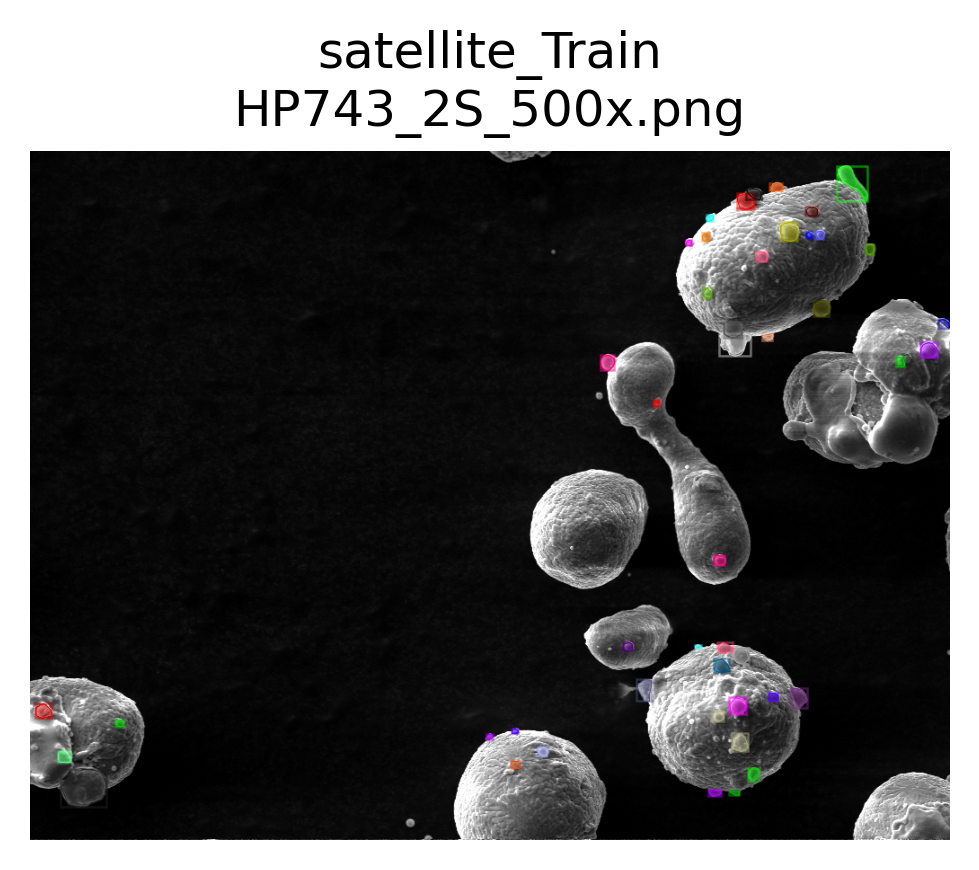

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_2S_500x.png
	num_instances: 47


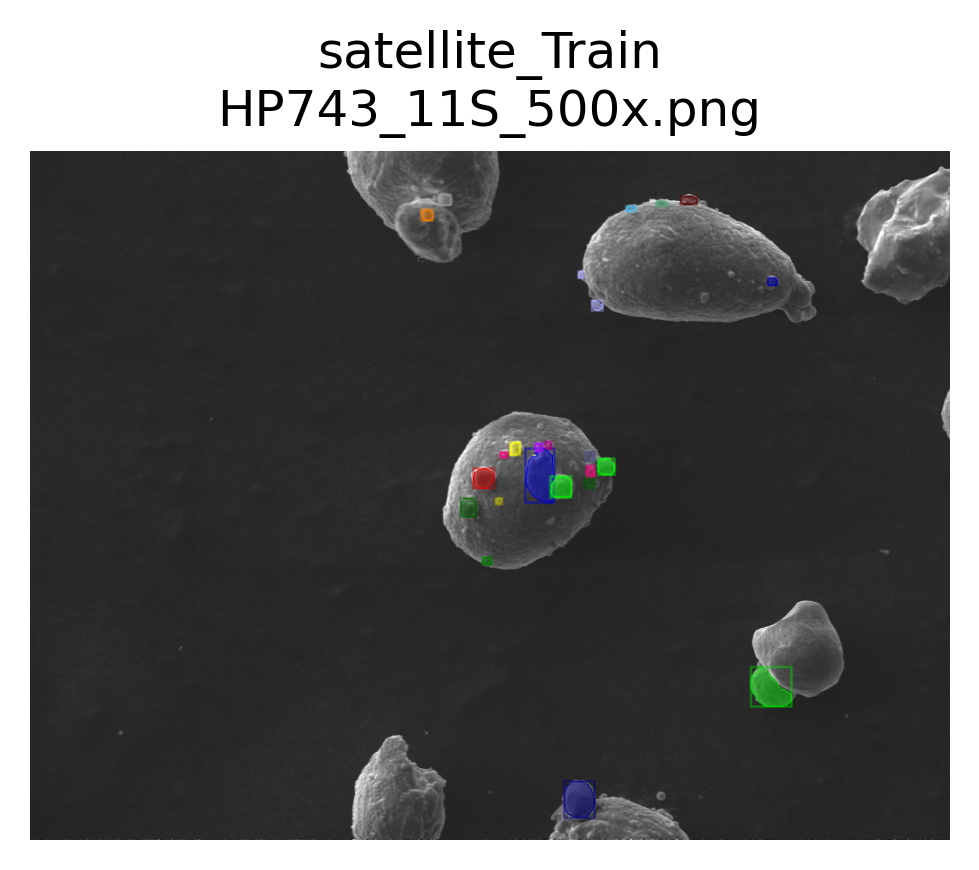

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_11S_500x.png
	num_instances: 25


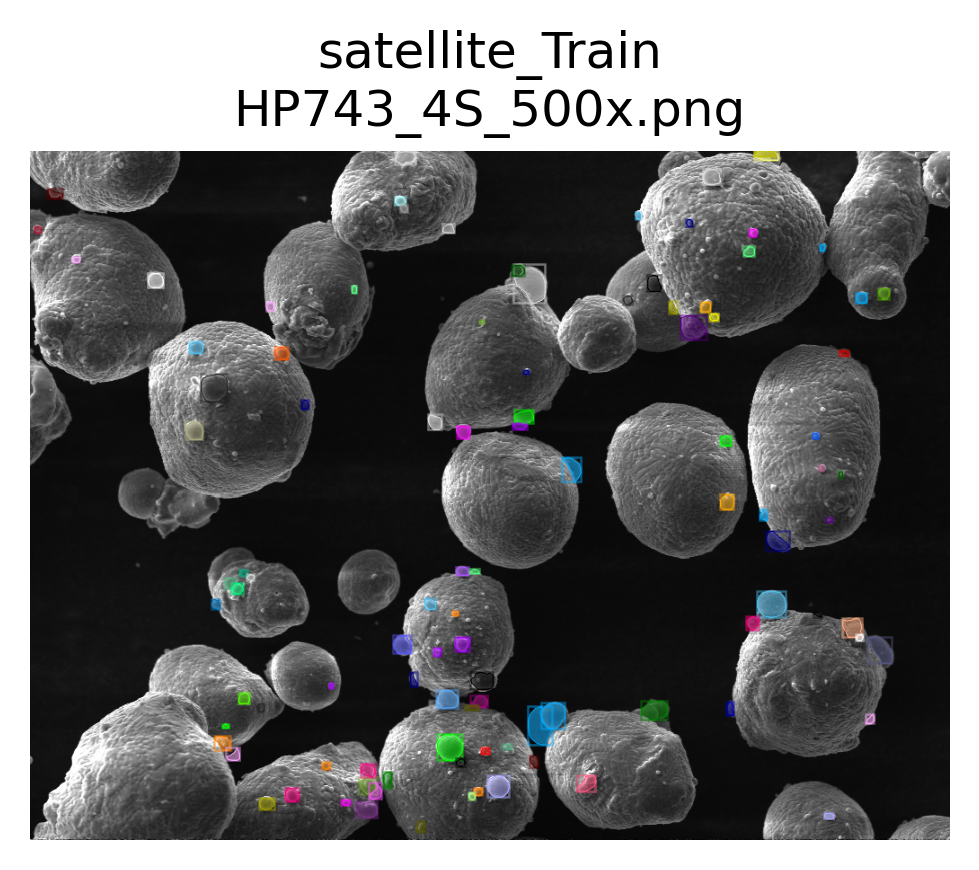

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_4S_500x.png
	num_instances: 103


In [4]:
for i in np.random.choice(DatasetCatalog.get(dataset_train), 3, replace=False):
    visualize.display_ddicts(i, None, dataset_train, suppress_labels=True)

### Validation Data

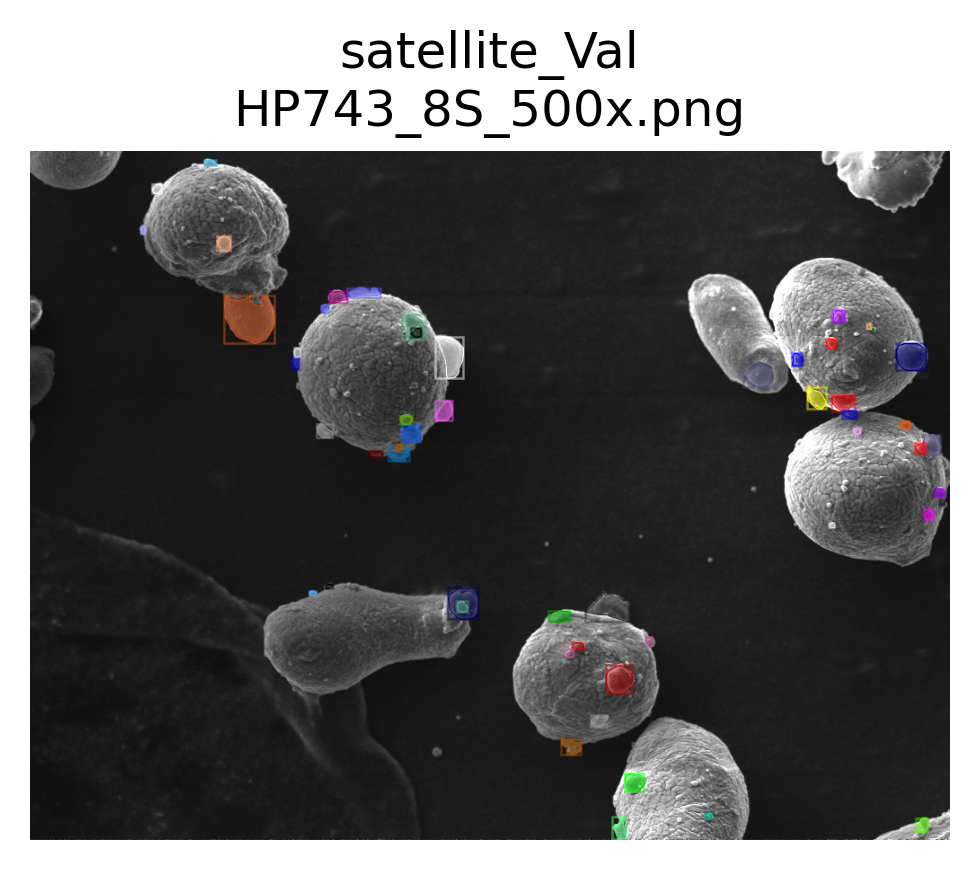

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_8S_500x.png
	num_instances: 54


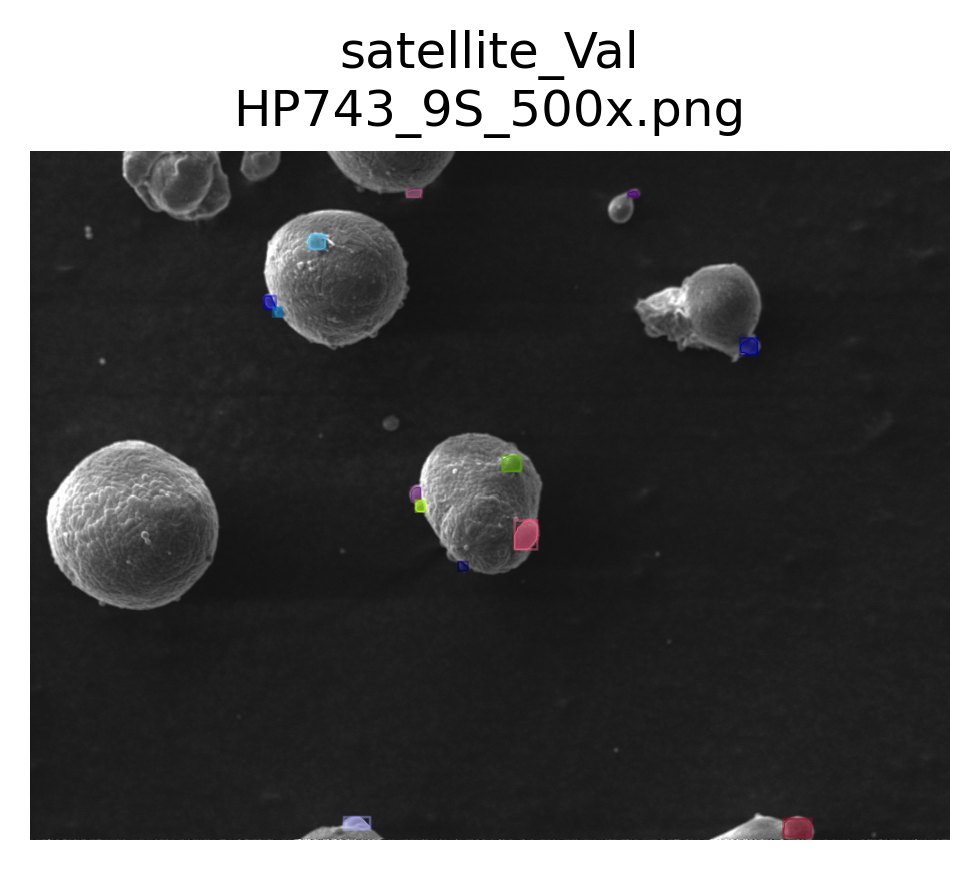

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_9S_500x.png
	num_instances: 13


In [5]:
for i in DatasetCatalog.get(dataset_valid):
    visualize.display_ddicts(i, None, dataset_valid, suppress_labels=True)

## Model Configuration
This is where we specify the directory where the outputs are saved, various hyperparameters for the model, and more.

In [8]:
cfg = get_cfg() # initialize cfg object
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))  # load default parameters for Mask R-CNN
cfg.INPUT.MASK_FORMAT = 'polygon'  # masks generated in VGG image annotator are polygons
cfg.DATASETS.TRAIN = (dataset_train,)  # dataset used for training model
cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # we will look at the predictions on both sets after training
cfg.SOLVER.IMS_PER_BATCH = 1 # number of images per batch (across all machines)
cfg.SOLVER.CHECKPOINT_PERIOD = 1000  # number of iterations after which to save model checkpoints
cfg.MODEL.DEVICE='cuda'  # 'cpu' to force model to run on cpu, 'cuda' if you have a compatible gpu
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Since we are training separate models for particles and satellites there is only one class output
cfg.TEST.DETECTIONS_PER_IMAGE = 400 if EXPERIMENT_NAME == 'particle' else 250  # maximum number of instances that can be detected in an image (this is fixed in mask r-cnn)
cfg.SOLVER.MAX_ITER = 5000  # maximum number of iterations to run during training
                            # Increasing this may improve the training results, but will take longer to run (especially without a gpu!)

# model weights will be downloaded if they are not present
weights_path = Path('..','..','models','model_final_f10217.pkl')
if weights_path.is_file():
    print('Using locally stored weights: {}'.format(weights_path))
else:
    weights_path = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
    print('Weights not found, weights will be downloaded from source: {}'.format(weights_path))
cfg.MODEL.WEIGHTs = str(weights_path)
cfg.OUTPUT_DIR = str(Path(f'{EXPERIMENT_NAME}_output_stage_7'))
# make the output directory
os.makedirs(Path(cfg.OUTPUT_DIR), exist_ok=True)

Weights not found, weights will be downloaded from source: https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl


# Model Training
Once we have everything set up, training is very easy!

Note- this block will generate a huge wall of text.

In [9]:
trainer = DefaultTrainer(cfg)  # create trainer object from cfg
trainer.resume_or_load(resume=False)  # start training from iteration 0
trainer.train()  # train the model!

[07/01 16:52:58 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

[07/01 16:52:59 d2.data.build]: Removed 0 images with no usable annotations. 22 images left.
[07/01 16:52:59 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[07/01 16:52:59 d2.data.build]: Using training sampler TrainingSampler
[07/01 16:52:59 d2.data.common]: Serializing 22 elements to byte tensors and concatenating them all ...
[07/01 16:52:59 d2.data.common]: Serialized dataset takes 0.49 MiB
WARNING [07/01 16:52:59 d2.solver.build]: SOLVER.STEPS contains values larger than SOLVER.MAX_ITER. These values will be ignored.
[07/01 16:52:59 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......
[07/01 16:52:59 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up:
| Names in Model    | Names in Checkpoint      | Shapes                                          |
|:------------------|:------------

[07/01 16:53:26 d2.utils.events]:  eta: 0:12:19  iter: 159  total_loss: 1.77  loss_cls: 0.2507  loss_box_reg: 0.2857  loss_mask: 0.3741  loss_rpn_cls: 0.2759  loss_rpn_loc: 0.4996  time: 0.1524  data_time: 0.0157  lr: 0.0031968  max_mem: 1995M
[07/01 16:53:29 d2.utils.events]:  eta: 0:12:18  iter: 179  total_loss: 1.895  loss_cls: 0.246  loss_box_reg: 0.3955  loss_mask: 0.4146  loss_rpn_cls: 0.2869  loss_rpn_loc: 0.5818  time: 0.1525  data_time: 0.0153  lr: 0.0035964  max_mem: 1995M
[07/01 16:53:32 d2.utils.events]:  eta: 0:12:16  iter: 199  total_loss: 2.013  loss_cls: 0.3051  loss_box_reg: 0.5262  loss_mask: 0.355  loss_rpn_cls: 0.337  loss_rpn_loc: 0.5171  time: 0.1528  data_time: 0.0151  lr: 0.003996  max_mem: 1995M
[07/01 16:53:35 d2.utils.events]:  eta: 0:12:18  iter: 219  total_loss: 1.78  loss_cls: 0.2414  loss_box_reg: 0.4363  loss_mask: 0.338  loss_rpn_cls: 0.2689  loss_rpn_loc: 0.4597  time: 0.1535  data_time: 0.0160  lr: 0.0043956  max_mem: 1995M
[07/01 16:53:38 d2.utils.ev

[07/01 16:55:11 d2.utils.events]:  eta: 0:11:01  iter: 819  total_loss: 1.497  loss_cls: 0.2017  loss_box_reg: 0.4037  loss_mask: 0.2329  loss_rpn_cls: 0.1958  loss_rpn_loc: 0.4438  time: 0.1578  data_time: 0.0154  lr: 0.016384  max_mem: 1995M
[07/01 16:55:14 d2.utils.events]:  eta: 0:10:57  iter: 839  total_loss: 1.527  loss_cls: 0.1913  loss_box_reg: 0.3579  loss_mask: 0.231  loss_rpn_cls: 0.2061  loss_rpn_loc: 0.5008  time: 0.1578  data_time: 0.0153  lr: 0.016783  max_mem: 1995M
[07/01 16:55:17 d2.utils.events]:  eta: 0:10:54  iter: 859  total_loss: 1.508  loss_cls: 0.2022  loss_box_reg: 0.3607  loss_mask: 0.2467  loss_rpn_cls: 0.1839  loss_rpn_loc: 0.4658  time: 0.1578  data_time: 0.0161  lr: 0.017183  max_mem: 1995M
[07/01 16:55:20 d2.utils.events]:  eta: 0:10:51  iter: 879  total_loss: 1.44  loss_cls: 0.1888  loss_box_reg: 0.3375  loss_mask: 0.2482  loss_rpn_cls: 0.1493  loss_rpn_loc: 0.4446  time: 0.1578  data_time: 0.0152  lr: 0.017582  max_mem: 1995M
[07/01 16:55:24 d2.utils.e

[07/01 16:56:56 d2.utils.events]:  eta: 0:09:18  iter: 1479  total_loss: 1.421  loss_cls: 0.1904  loss_box_reg: 0.3606  loss_mask: 0.233  loss_rpn_cls: 0.1522  loss_rpn_loc: 0.4393  time: 0.1580  data_time: 0.0148  lr: 0.02  max_mem: 1995M
[07/01 16:57:00 d2.utils.events]:  eta: 0:09:15  iter: 1499  total_loss: 1.425  loss_cls: 0.2112  loss_box_reg: 0.3935  loss_mask: 0.2323  loss_rpn_cls: 0.1475  loss_rpn_loc: 0.4197  time: 0.1581  data_time: 0.0154  lr: 0.02  max_mem: 1995M
[07/01 16:57:03 d2.utils.events]:  eta: 0:09:12  iter: 1519  total_loss: 1.348  loss_cls: 0.1973  loss_box_reg: 0.3983  loss_mask: 0.2097  loss_rpn_cls: 0.1454  loss_rpn_loc: 0.3866  time: 0.1581  data_time: 0.0159  lr: 0.02  max_mem: 1995M
[07/01 16:57:06 d2.utils.events]:  eta: 0:09:09  iter: 1539  total_loss: 1.349  loss_cls: 0.2264  loss_box_reg: 0.4288  loss_mask: 0.1996  loss_rpn_cls: 0.1233  loss_rpn_loc: 0.3749  time: 0.1581  data_time: 0.0159  lr: 0.02  max_mem: 1995M
[07/01 16:57:09 d2.utils.events]:  et

[07/01 16:58:43 d2.utils.events]:  eta: 0:07:35  iter: 2139  total_loss: 1.311  loss_cls: 0.2011  loss_box_reg: 0.4099  loss_mask: 0.1882  loss_rpn_cls: 0.1241  loss_rpn_loc: 0.3532  time: 0.1586  data_time: 0.0156  lr: 0.02  max_mem: 1995M
[07/01 16:58:46 d2.utils.events]:  eta: 0:07:32  iter: 2159  total_loss: 1.301  loss_cls: 0.1947  loss_box_reg: 0.3802  loss_mask: 0.2007  loss_rpn_cls: 0.1504  loss_rpn_loc: 0.3821  time: 0.1586  data_time: 0.0156  lr: 0.02  max_mem: 1995M
[07/01 16:58:49 d2.utils.events]:  eta: 0:07:29  iter: 2179  total_loss: 1.316  loss_cls: 0.1891  loss_box_reg: 0.3857  loss_mask: 0.1973  loss_rpn_cls: 0.1403  loss_rpn_loc: 0.3896  time: 0.1586  data_time: 0.0153  lr: 0.02  max_mem: 1995M
[07/01 16:58:52 d2.utils.events]:  eta: 0:07:26  iter: 2199  total_loss: 1.267  loss_cls: 0.1857  loss_box_reg: 0.3759  loss_mask: 0.1941  loss_rpn_cls: 0.1334  loss_rpn_loc: 0.372  time: 0.1586  data_time: 0.0156  lr: 0.02  max_mem: 1995M
[07/01 16:58:56 d2.utils.events]:  et

[07/01 17:00:30 d2.utils.events]:  eta: 0:05:51  iter: 2799  total_loss: 1.217  loss_cls: 0.1664  loss_box_reg: 0.3903  loss_mask: 0.183  loss_rpn_cls: 0.1112  loss_rpn_loc: 0.3541  time: 0.1592  data_time: 0.0152  lr: 0.02  max_mem: 1995M
[07/01 17:00:33 d2.utils.events]:  eta: 0:05:47  iter: 2819  total_loss: 1.247  loss_cls: 0.1881  loss_box_reg: 0.3997  loss_mask: 0.1906  loss_rpn_cls: 0.1111  loss_rpn_loc: 0.3235  time: 0.1592  data_time: 0.0153  lr: 0.02  max_mem: 1995M
[07/01 17:00:36 d2.utils.events]:  eta: 0:05:44  iter: 2839  total_loss: 1.201  loss_cls: 0.1667  loss_box_reg: 0.3849  loss_mask: 0.1974  loss_rpn_cls: 0.1022  loss_rpn_loc: 0.3555  time: 0.1592  data_time: 0.0153  lr: 0.02  max_mem: 1995M
[07/01 17:00:39 d2.utils.events]:  eta: 0:05:41  iter: 2859  total_loss: 1.196  loss_cls: 0.1887  loss_box_reg: 0.4016  loss_mask: 0.1816  loss_rpn_cls: 0.09952  loss_rpn_loc: 0.3234  time: 0.1592  data_time: 0.0150  lr: 0.02  max_mem: 1995M
[07/01 17:00:42 d2.utils.events]:  e

[07/01 17:02:16 d2.utils.events]:  eta: 0:04:07  iter: 3459  total_loss: 1.168  loss_cls: 0.1589  loss_box_reg: 0.374  loss_mask: 0.1694  loss_rpn_cls: 0.07439  loss_rpn_loc: 0.3242  time: 0.1594  data_time: 0.0156  lr: 0.02  max_mem: 1995M
[07/01 17:02:20 d2.utils.events]:  eta: 0:04:04  iter: 3479  total_loss: 1.085  loss_cls: 0.1745  loss_box_reg: 0.3595  loss_mask: 0.1685  loss_rpn_cls: 0.09199  loss_rpn_loc: 0.3111  time: 0.1594  data_time: 0.0146  lr: 0.02  max_mem: 1995M
[07/01 17:02:23 d2.utils.events]:  eta: 0:04:00  iter: 3499  total_loss: 1.108  loss_cls: 0.1759  loss_box_reg: 0.3539  loss_mask: 0.1657  loss_rpn_cls: 0.08583  loss_rpn_loc: 0.2978  time: 0.1594  data_time: 0.0158  lr: 0.02  max_mem: 1995M
[07/01 17:02:26 d2.utils.events]:  eta: 0:03:57  iter: 3519  total_loss: 1.2  loss_cls: 0.1961  loss_box_reg: 0.3756  loss_mask: 0.1708  loss_rpn_cls: 0.09468  loss_rpn_loc: 0.3295  time: 0.1594  data_time: 0.0157  lr: 0.02  max_mem: 1995M
[07/01 17:02:29 d2.utils.events]:  

[07/01 17:04:03 d2.utils.events]:  eta: 0:02:20  iter: 4119  total_loss: 1.113  loss_cls: 0.1629  loss_box_reg: 0.3299  loss_mask: 0.1601  loss_rpn_cls: 0.1637  loss_rpn_loc: 0.3283  time: 0.1595  data_time: 0.0154  lr: 0.02  max_mem: 1995M
[07/01 17:04:06 d2.utils.events]:  eta: 0:02:17  iter: 4139  total_loss: 1.081  loss_cls: 0.1674  loss_box_reg: 0.3532  loss_mask: 0.1602  loss_rpn_cls: 0.06822  loss_rpn_loc: 0.2983  time: 0.1595  data_time: 0.0158  lr: 0.02  max_mem: 1995M
[07/01 17:04:09 d2.utils.events]:  eta: 0:02:14  iter: 4159  total_loss: 1.015  loss_cls: 0.1389  loss_box_reg: 0.3029  loss_mask: 0.1571  loss_rpn_cls: 0.08405  loss_rpn_loc: 0.3333  time: 0.1595  data_time: 0.0154  lr: 0.02  max_mem: 1995M
[07/01 17:04:12 d2.utils.events]:  eta: 0:02:11  iter: 4179  total_loss: 1.039  loss_cls: 0.1488  loss_box_reg: 0.313  loss_mask: 0.1636  loss_rpn_cls: 0.1068  loss_rpn_loc: 0.2985  time: 0.1595  data_time: 0.0157  lr: 0.02  max_mem: 1995M
[07/01 17:04:16 d2.utils.events]:  

[07/01 17:05:50 d2.utils.events]:  eta: 0:00:35  iter: 4779  total_loss: 1.004  loss_cls: 0.1567  loss_box_reg: 0.3216  loss_mask: 0.1514  loss_rpn_cls: 0.09268  loss_rpn_loc: 0.2969  time: 0.1598  data_time: 0.0157  lr: 0.02  max_mem: 1995M
[07/01 17:05:53 d2.utils.events]:  eta: 0:00:32  iter: 4799  total_loss: 1.022  loss_cls: 0.1379  loss_box_reg: 0.3512  loss_mask: 0.1527  loss_rpn_cls: 0.06581  loss_rpn_loc: 0.3103  time: 0.1598  data_time: 0.0159  lr: 0.02  max_mem: 1995M
[07/01 17:05:56 d2.utils.events]:  eta: 0:00:28  iter: 4819  total_loss: 1.001  loss_cls: 0.1502  loss_box_reg: 0.3117  loss_mask: 0.1485  loss_rpn_cls: 0.1177  loss_rpn_loc: 0.3026  time: 0.1597  data_time: 0.0151  lr: 0.02  max_mem: 1995M
[07/01 17:05:59 d2.utils.events]:  eta: 0:00:25  iter: 4839  total_loss: 1.045  loss_cls: 0.1498  loss_box_reg: 0.3337  loss_mask: 0.157  loss_rpn_cls: 0.08493  loss_rpn_loc: 0.2889  time: 0.1598  data_time: 0.0155  lr: 0.02  max_mem: 1995M
[07/01 17:06:03 d2.utils.events]: 

# Visualizing model predictions
We will view the model predictions on the training and validation set.

In [6]:
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
#cfg.DATASETS.TEST = (dataset_train, dataset_valid)  # predictor requires this field to not be empty
cfg.MODEL.WEIGHTS = str(model_checkpoints[-1])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.
predictor = DefaultPredictor(cfg)  # create predictor object

## Generating predictions on new images is simple.
We will load a new image (not included in either dataset) and generate predictions.
Note that we do not have labels for this image and do not need to register it to a dataset.

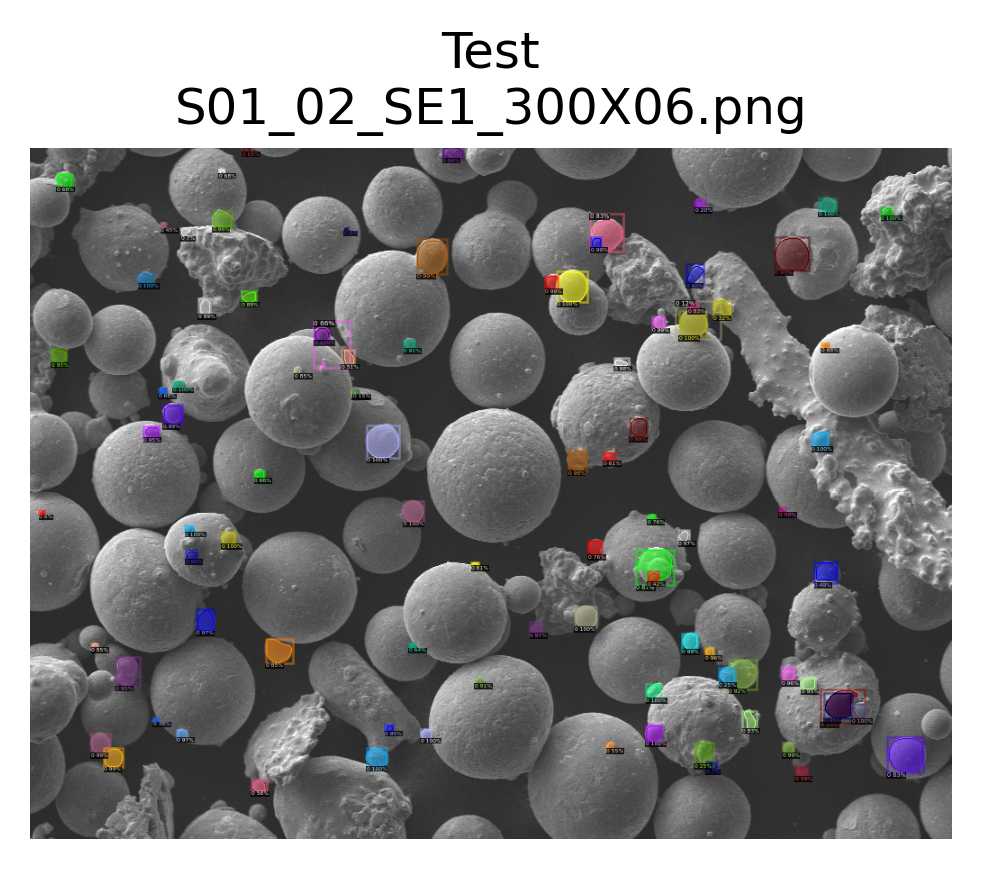

ddict info:
	path: Auto_annotate_images/S01_02_SE1_300X06.png
	num_instances: 94


In [7]:
img_path = Path('Auto_annotate_images','S01_02_SE1_300X06.png')
img = cv2.imread(str(img_path))
outs = predictor(img)
data_utils.format_outputs(img_path, dataset='test', pred=outs)
visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save figure
                                 gt=False,  # specifies format as model predictions
                                img_path=img_path)  # path to image


We will now generate predictions on all of the images in the training and validation sets, and save the results for later.

Dataset: satellite_Train
	File: training_sets/AL_5056/PNG_Format/500x/HP743_4S_500x.png


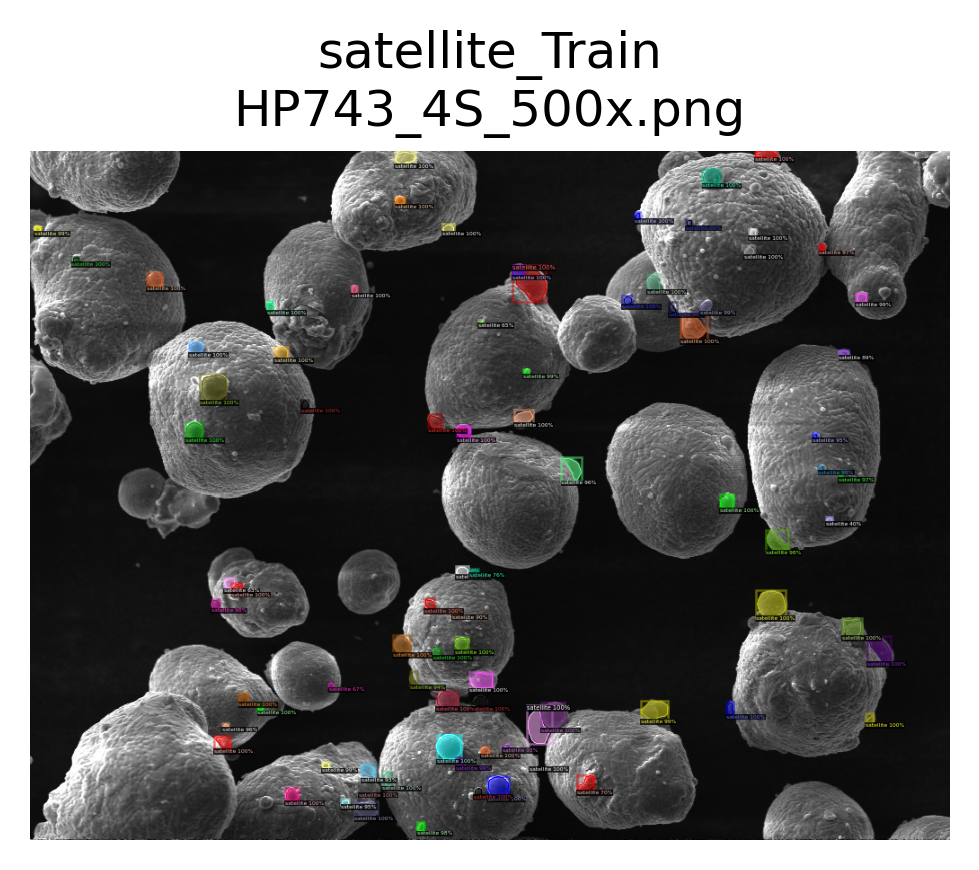

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_4S_500x.png
	num_instances: 84
	File: training_sets/AL_5056/PNG_Format/500x/HP743_2S_500x.png


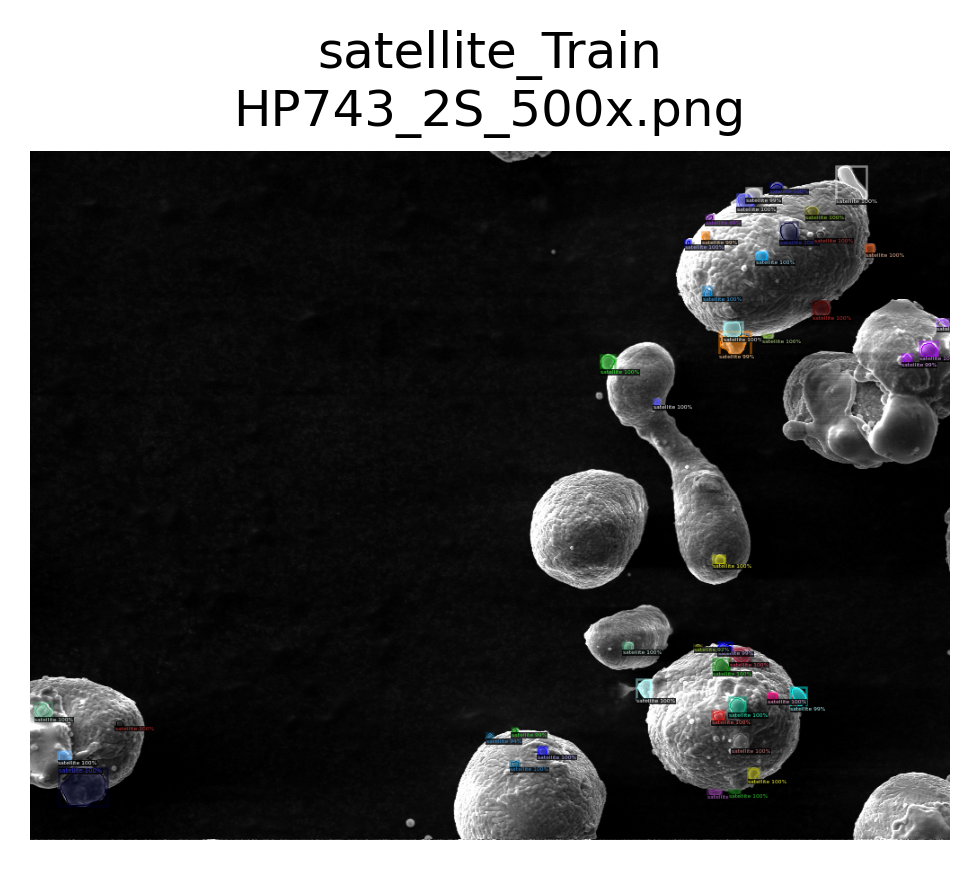

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_2S_500x.png
	num_instances: 45
	File: training_sets/AL_5056/PNG_Format/500x/HP743_11S_500x.png


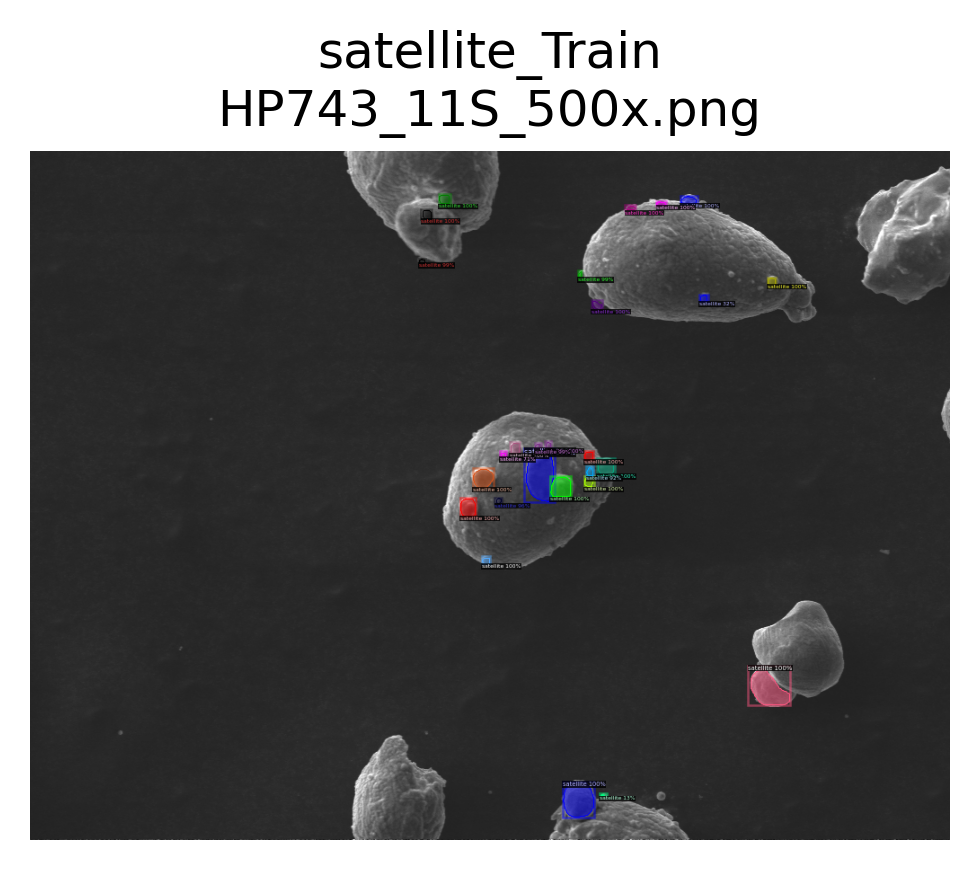

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_11S_500x.png
	num_instances: 27
	File: training_sets/AL_5056/PNG_Format/500x/HP743_10S_500x.png


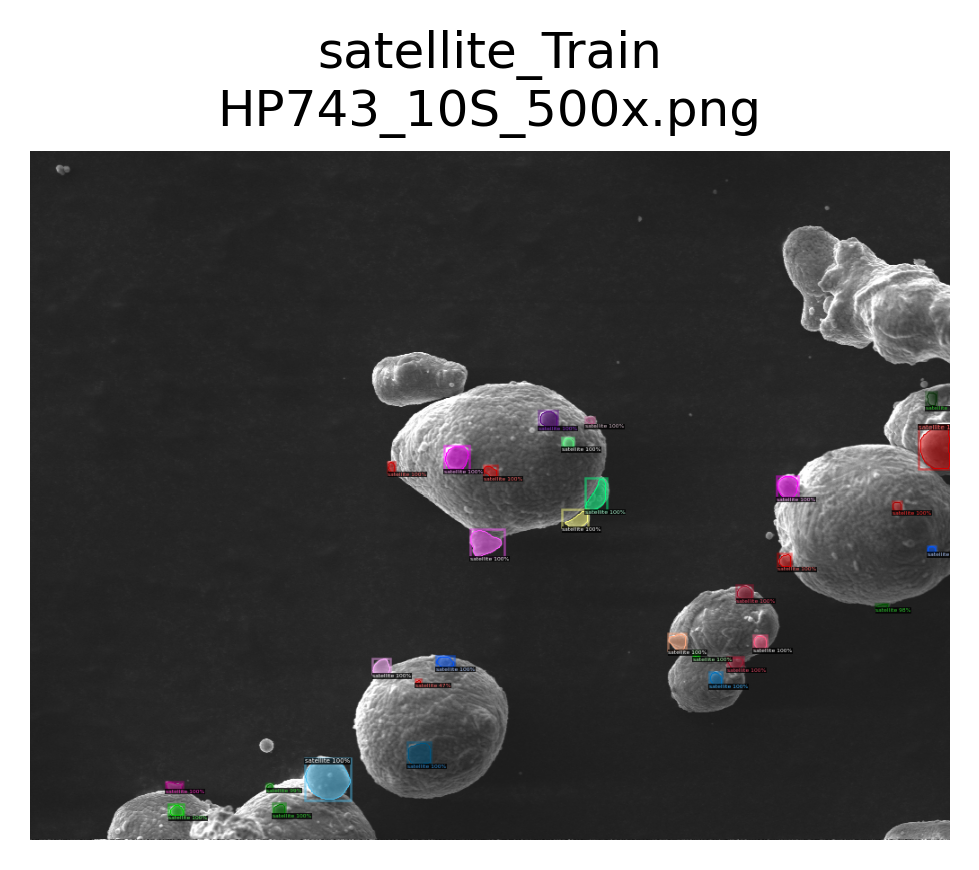

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_10S_500x.png
	num_instances: 31
	File: training_sets/AL_5056/PNG_Format/500x/HP743_12S_500x.png


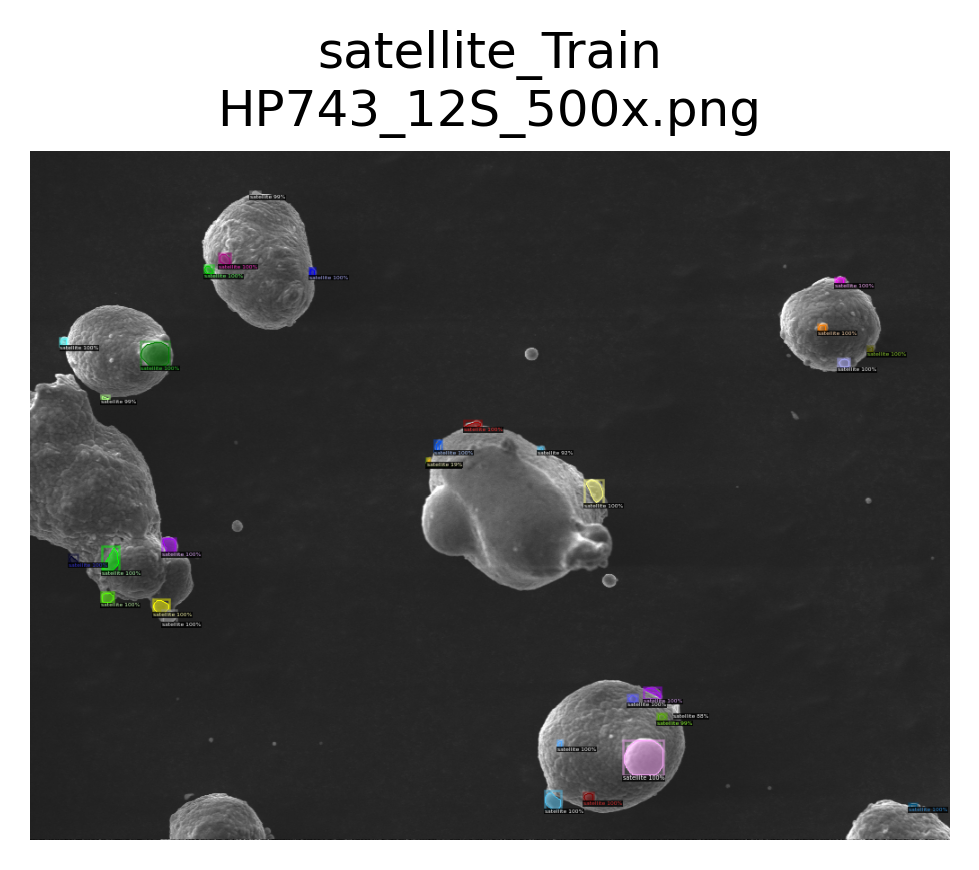

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_12S_500x.png
	num_instances: 32
	File: training_sets/AL_5056/PNG_Format/500x/HP743_3S_500x.png


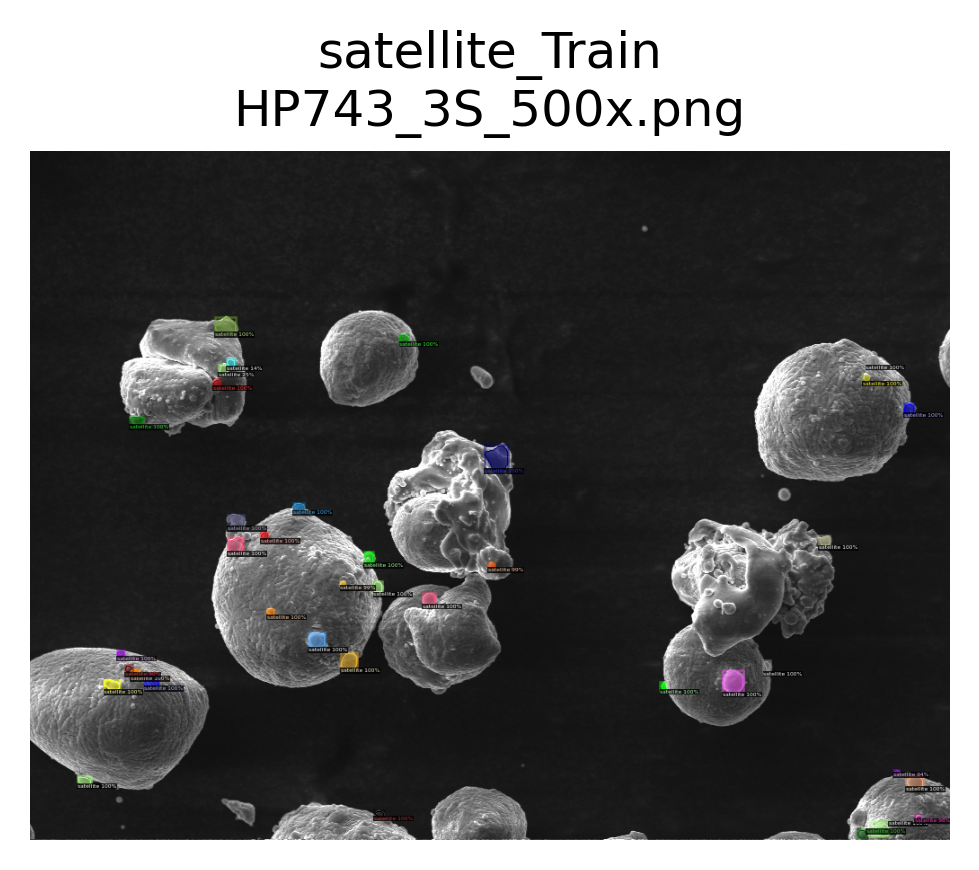

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_3S_500x.png
	num_instances: 38
	File: training_sets/AL_5056/PNG_Format/500x/HP743_1S_500x.png


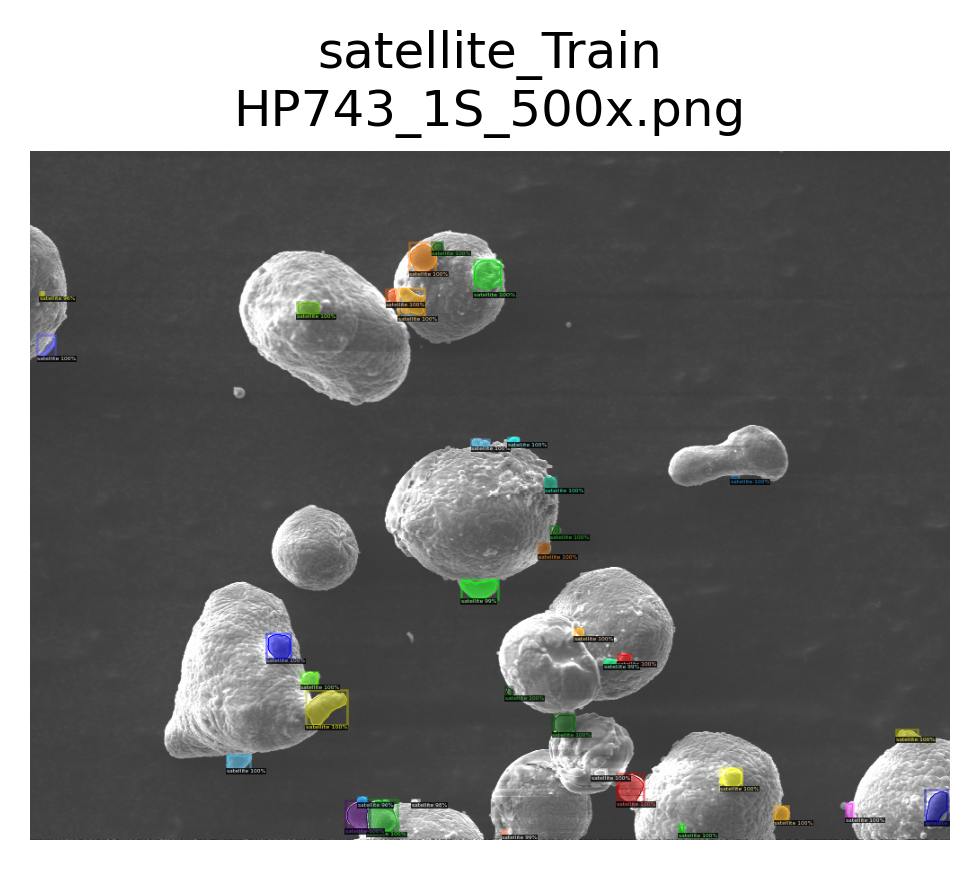

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_1S_500x.png
	num_instances: 37
	File: training_sets/AL_5056/PNG_Format/500x/HP743_5S_500x.png


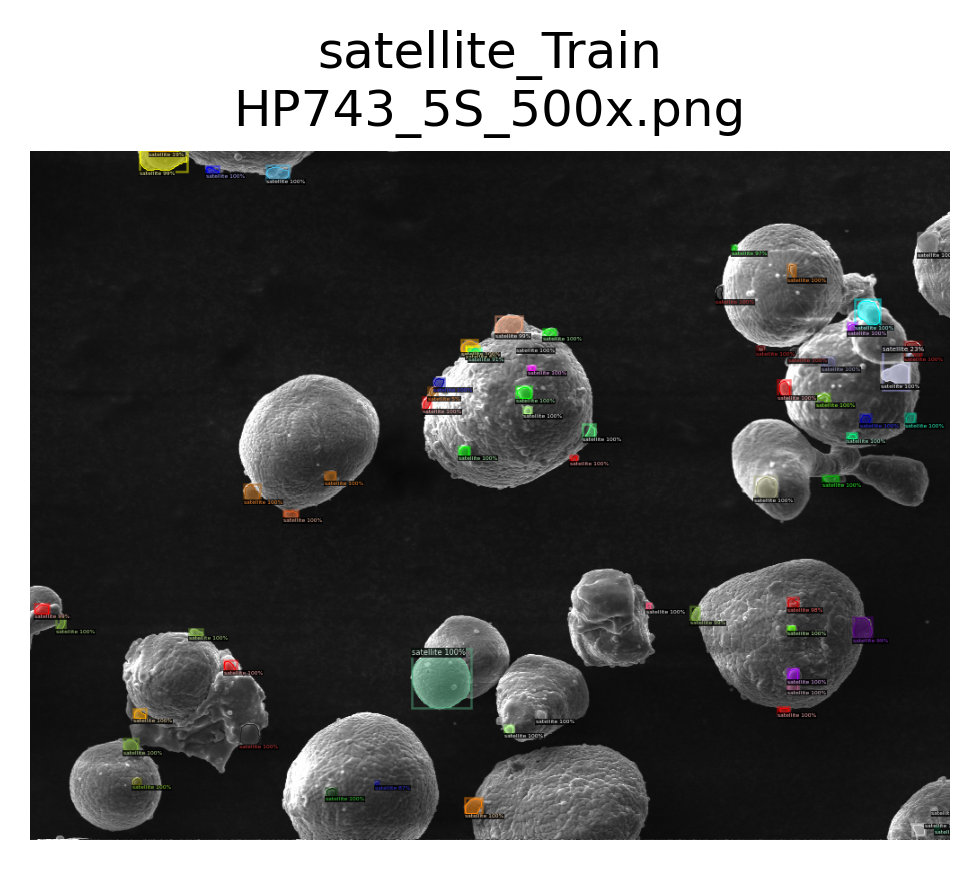

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_5S_500x.png
	num_instances: 66
Dataset: satellite_Val
	File: training_sets/AL_5056/PNG_Format/500x/HP743_8S_500x.png


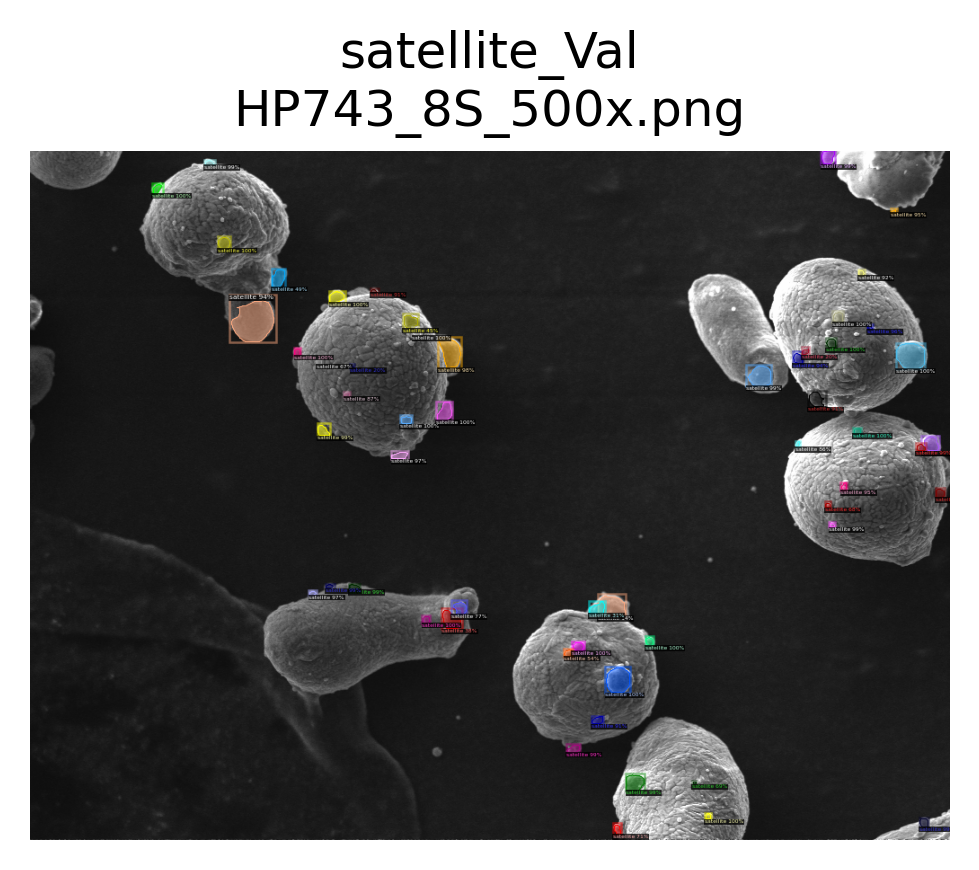

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_8S_500x.png
	num_instances: 56
	File: training_sets/AL_5056/PNG_Format/500x/HP743_9S_500x.png


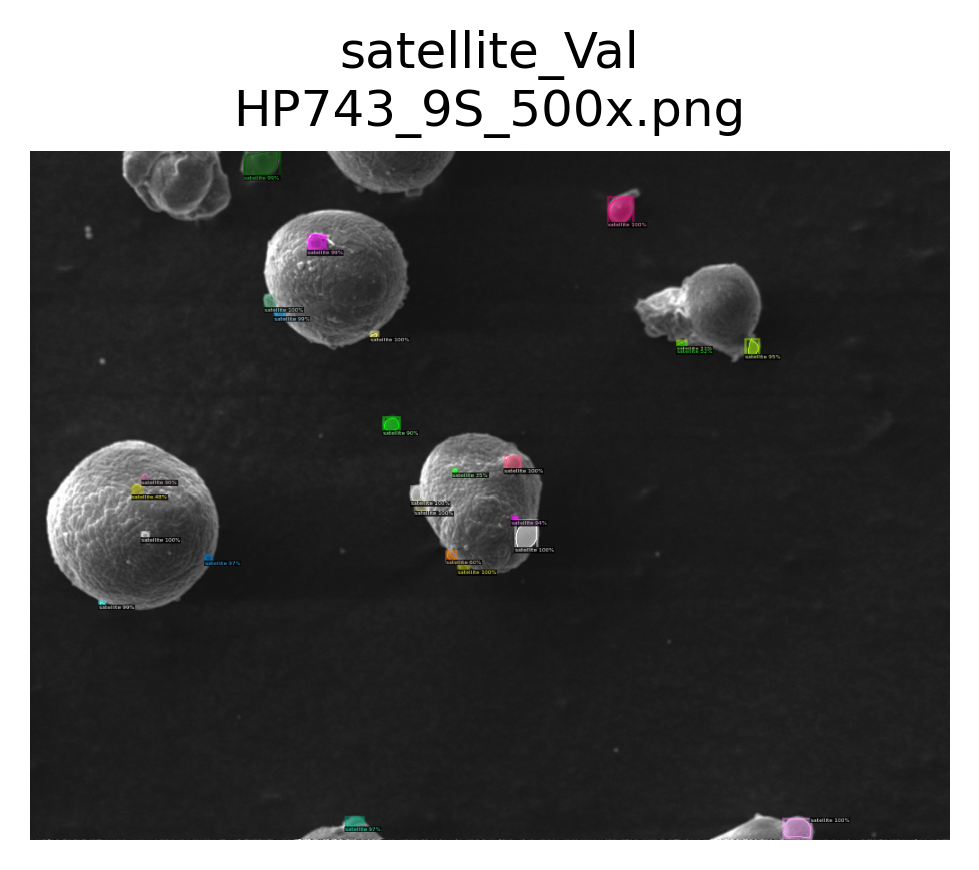

ddict info:
	path: training_sets/AL_5056/PNG_Format/500x/HP743_9S_500x.png
	num_instances: 25


In [13]:
results = []
for ds in cfg.DATASETS.TEST:
    print(f'Dataset: {ds}')
    for dd in DatasetCatalog.get(ds):
        print(f'\tFile: {dd["file_name"]}')
        img = cv2.imread(dd['file_name'])  # load image
        outs = predictor(img)  # run inference on image
        
        # format results for visualization and store for later
        results.append(data_utils.format_outputs(dd['file_name'], ds, outs))

        # visualize results
        visualize.display_ddicts(outs, None, ds, gt=False, img_path=dd['file_name'])

# save to disk
with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
    pickle.dump(results, f)

Annotating: S05_02_SE1_300X59


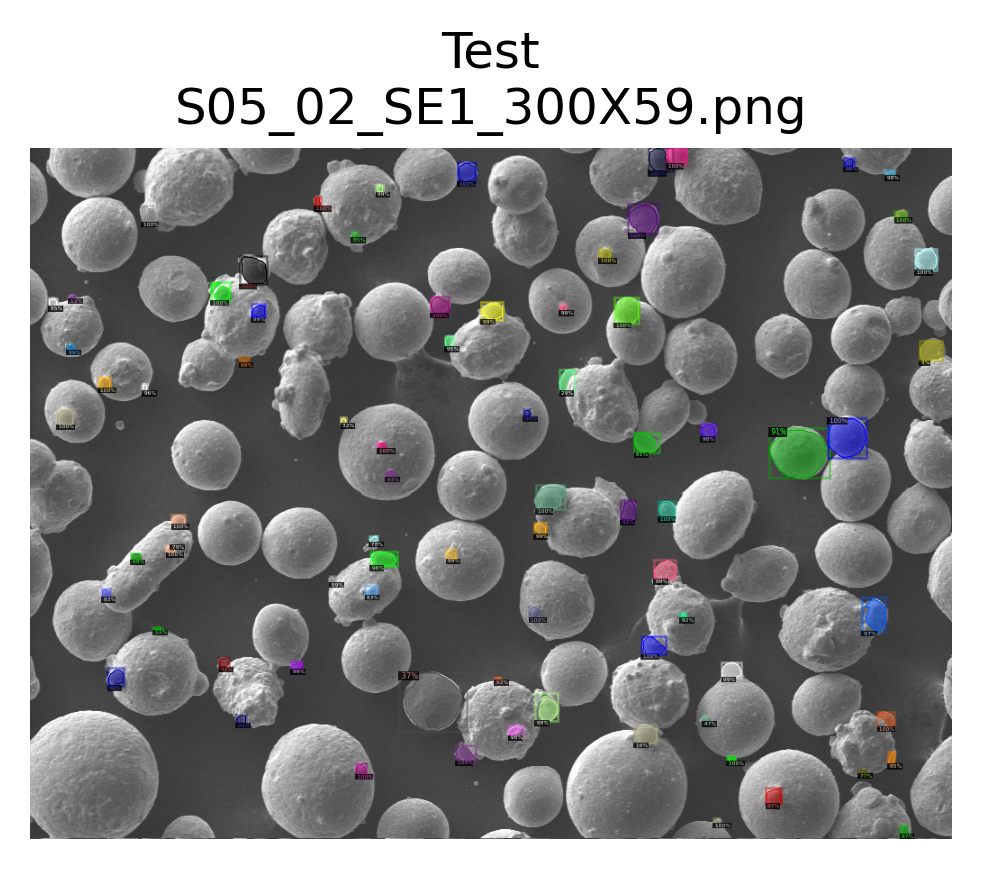

ddict info:
	path: Auto_annotate_images/S05_02_SE1_300X59.png
	num_instances: 78
Annotating: S07_01_SE1_300X81


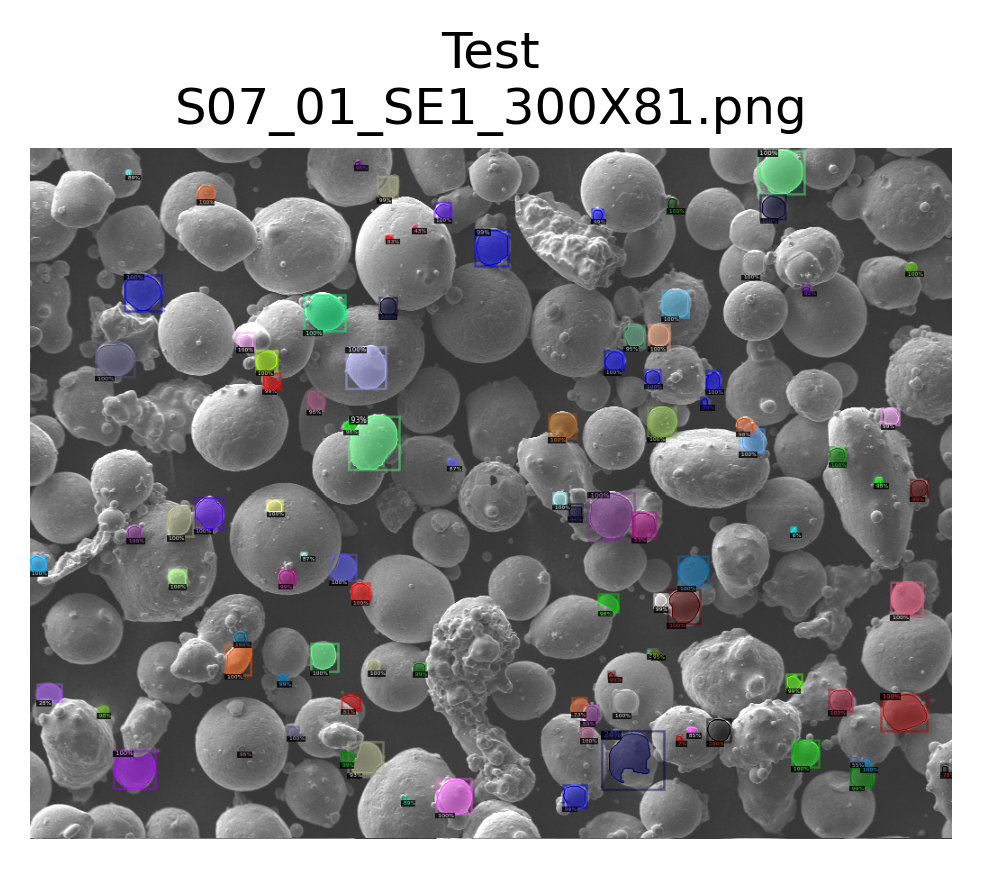

ddict info:
	path: Auto_annotate_images/S07_01_SE1_300X81.png
	num_instances: 98
Annotating: S04_03_SE1_1000X53


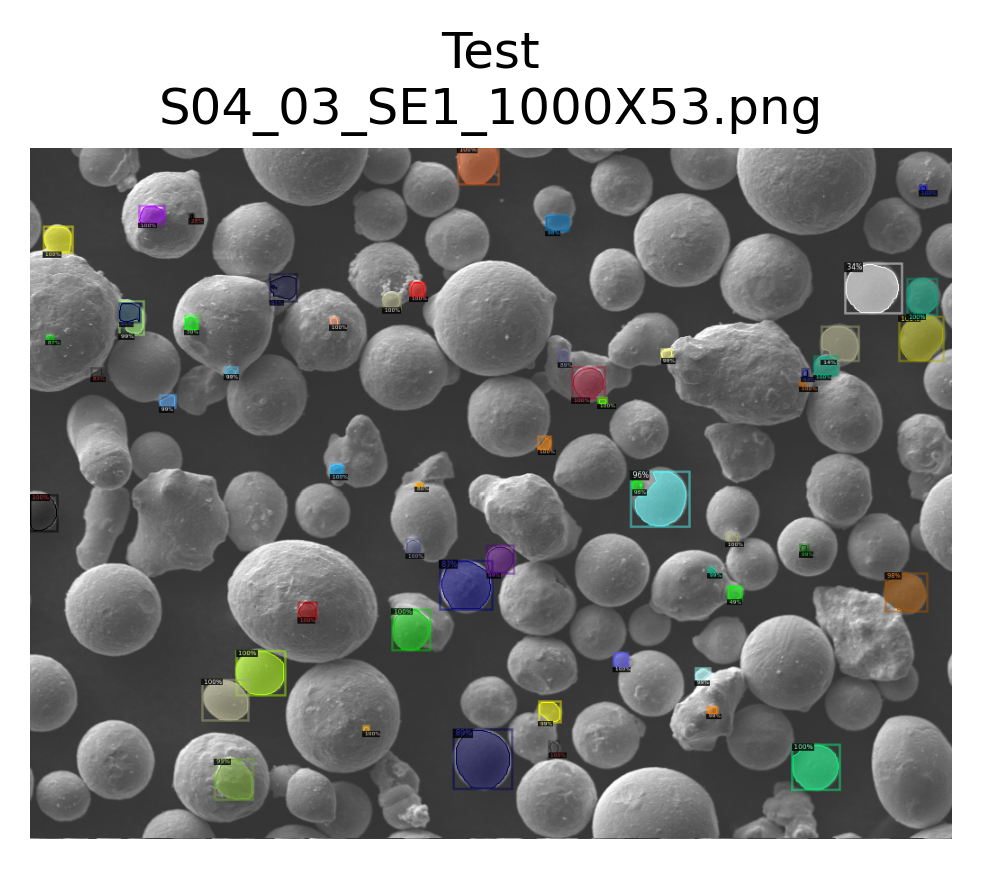

ddict info:
	path: Auto_annotate_images/S04_03_SE1_1000X53.png
	num_instances: 55
Annotating: S07_03_SE1_1000X91


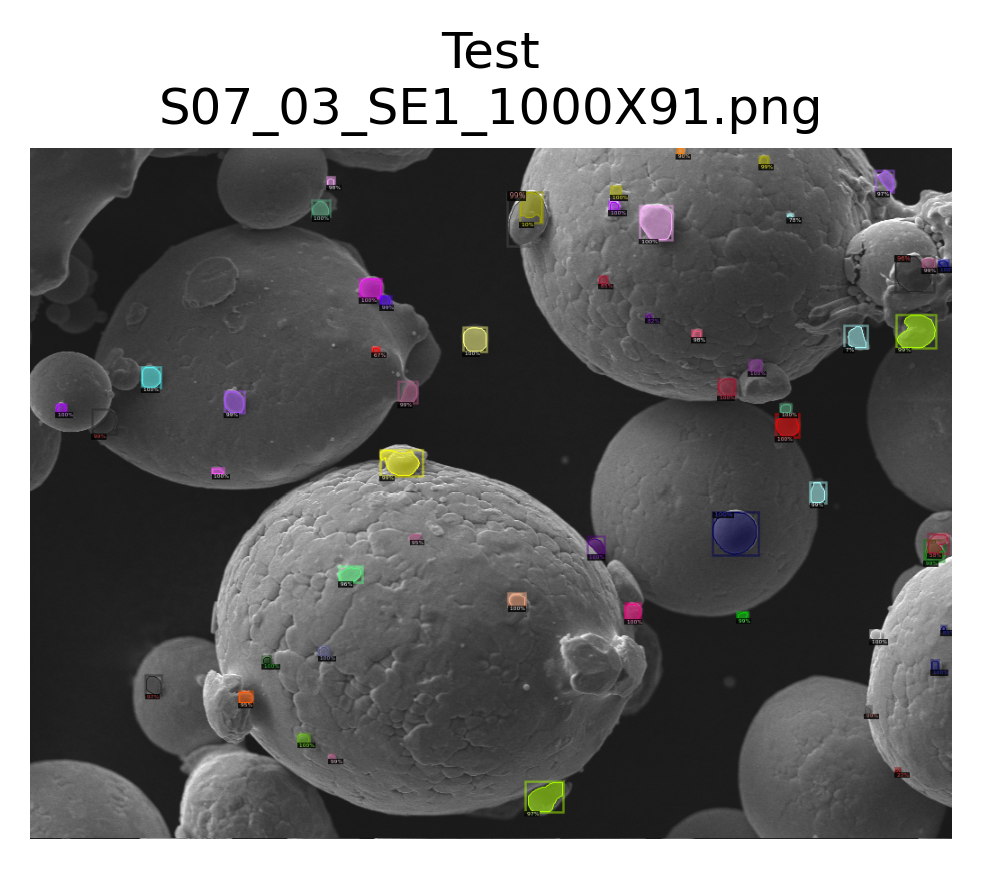

ddict info:
	path: Auto_annotate_images/S07_03_SE1_1000X91.png
	num_instances: 56
Annotating: S04_01_SE1_1000X45


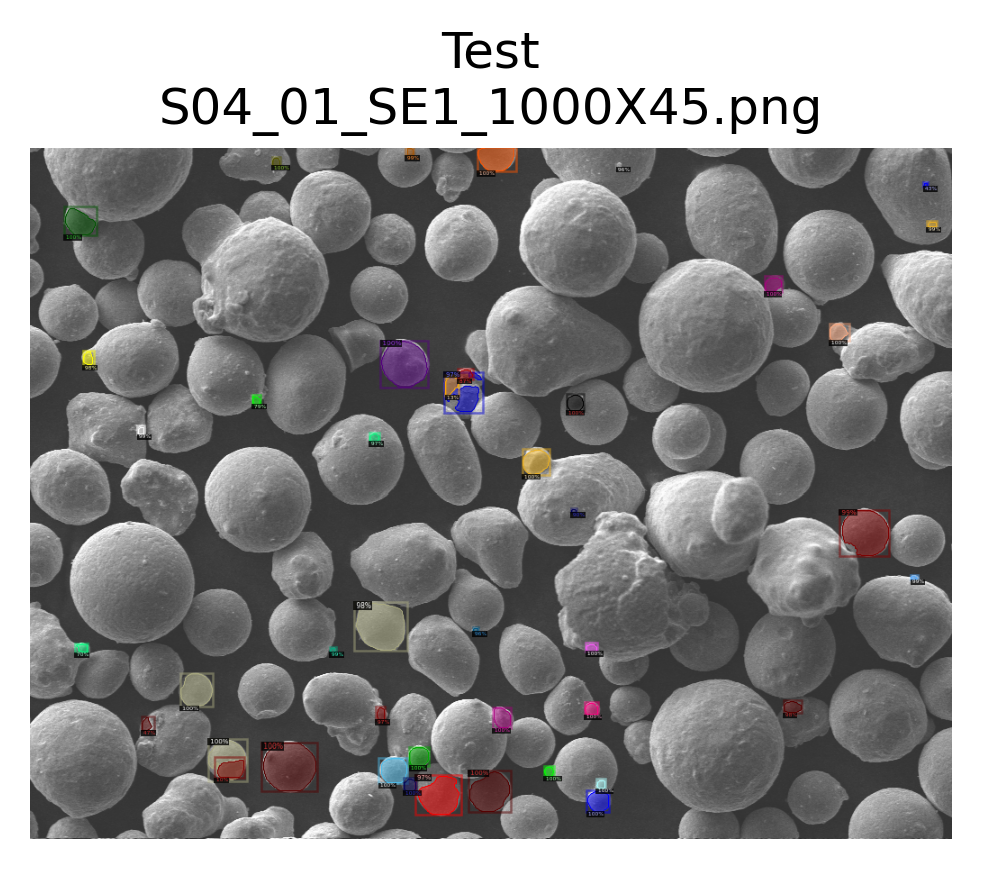

ddict info:
	path: Auto_annotate_images/S04_01_SE1_1000X45.png
	num_instances: 44
Annotating: S05_03_SE1_300X63


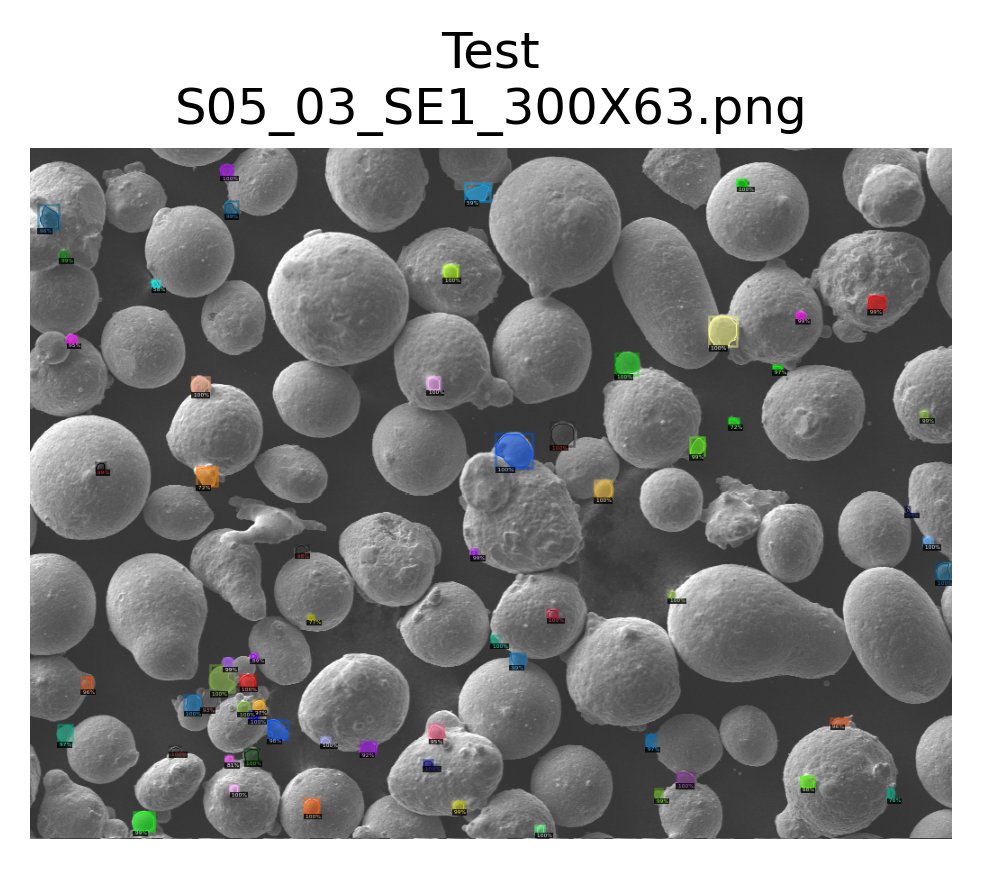

ddict info:
	path: Auto_annotate_images/S05_03_SE1_300X63.png
	num_instances: 64
Annotating: S03_03_SE1_3000X42


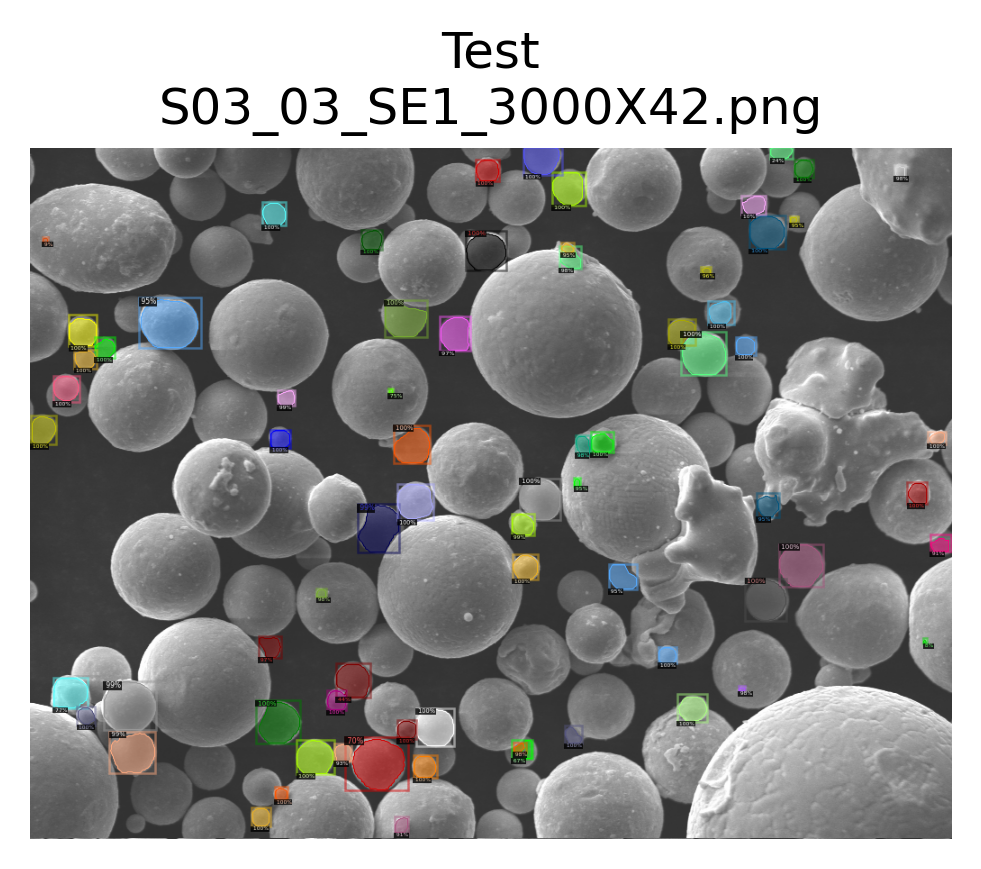

ddict info:
	path: Auto_annotate_images/S03_03_SE1_3000X42.png
	num_instances: 72
Annotating: S02_02_SE1_1000X20


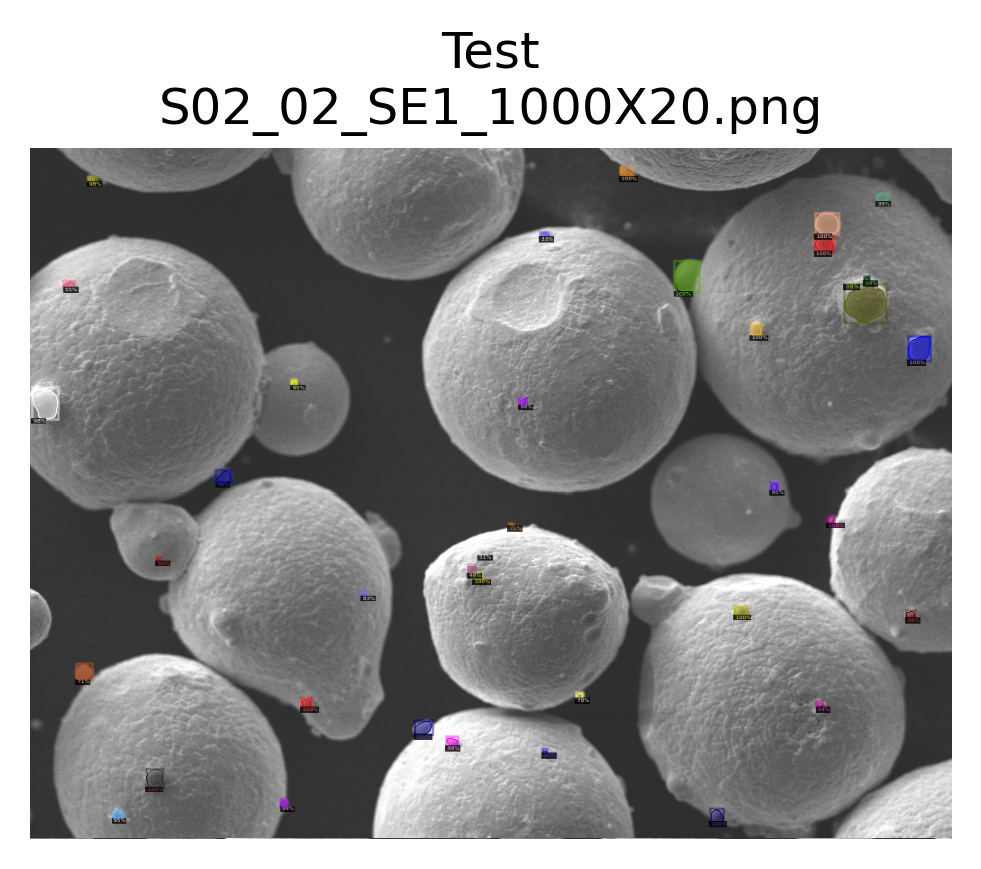

ddict info:
	path: Auto_annotate_images/S02_02_SE1_1000X20.png
	num_instances: 37
Annotating: S03_02_SE1_3000X36


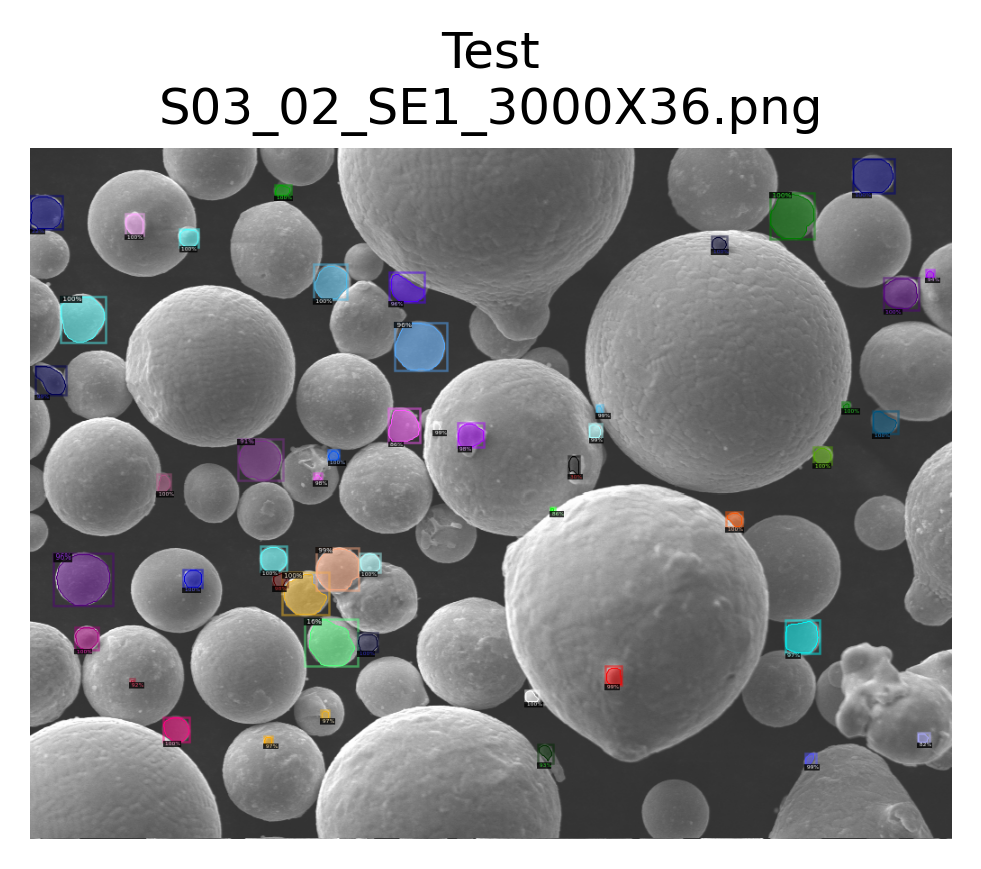

ddict info:
	path: Auto_annotate_images/S03_02_SE1_3000X36.png
	num_instances: 49
Annotating: S03_02_SE1_1250X35


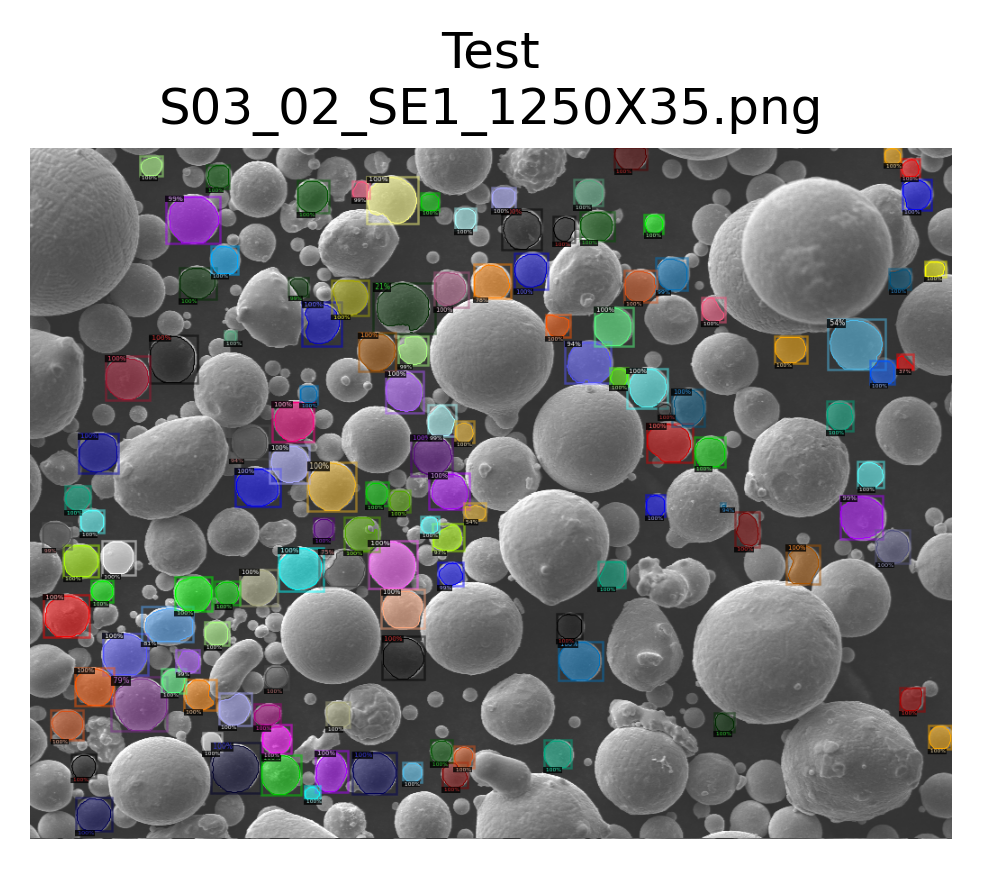

ddict info:
	path: Auto_annotate_images/S03_02_SE1_1250X35.png
	num_instances: 126
Annotating: S06_01_SE1_300X68


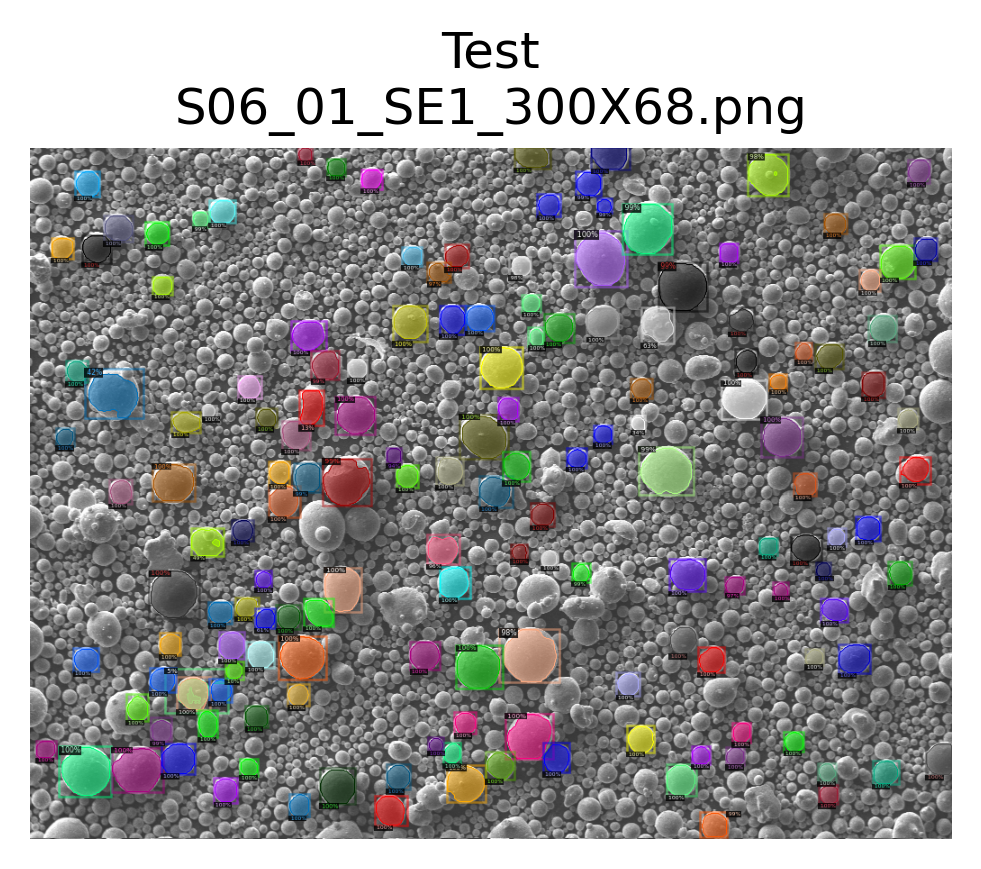

ddict info:
	path: Auto_annotate_images/S06_01_SE1_300X68.png
	num_instances: 159
Annotating: S02_03_SE1_500X23


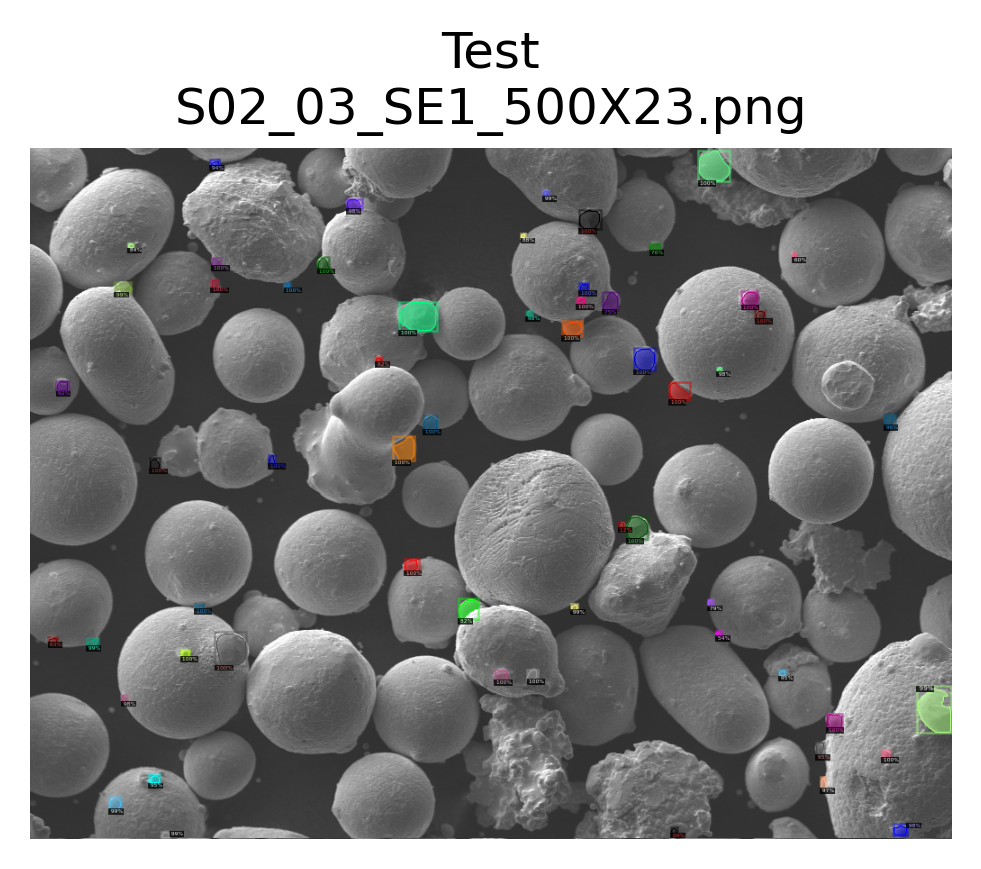

ddict info:
	path: Auto_annotate_images/S02_03_SE1_500X23.png
	num_instances: 58
Annotating: S05_01_SE1_300X56


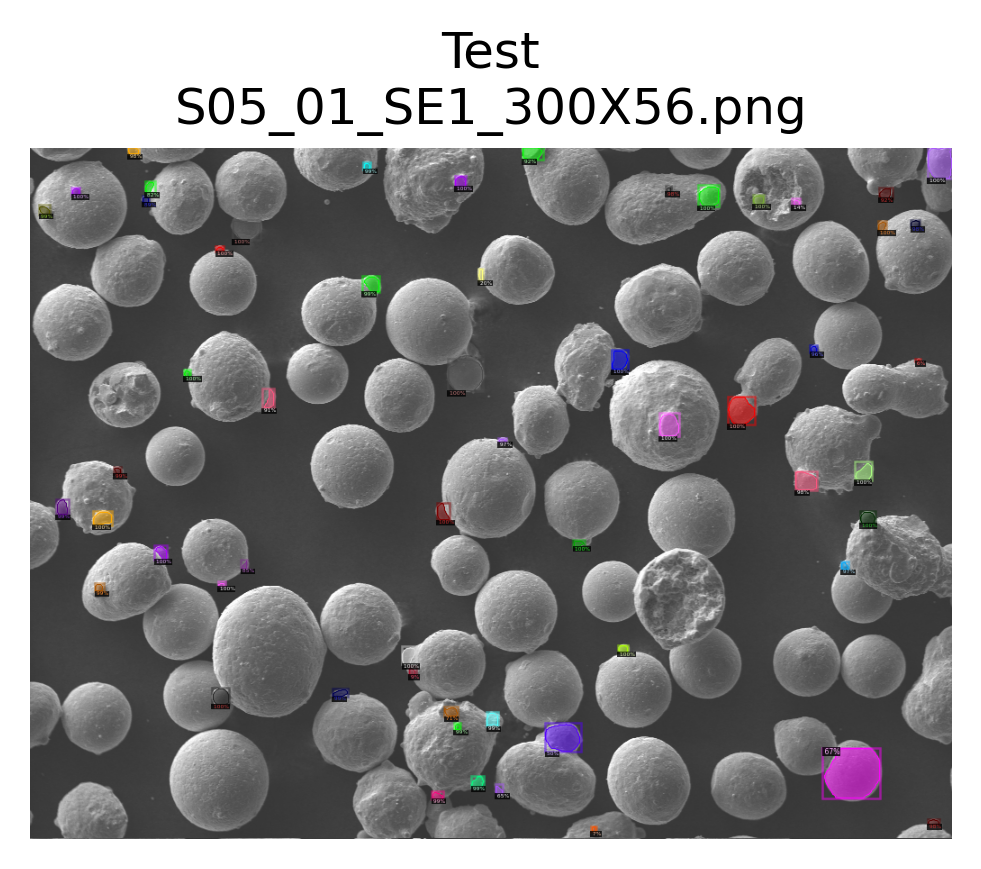

ddict info:
	path: Auto_annotate_images/S05_01_SE1_300X56.png
	num_instances: 57
Annotating: S02_01_SE1_500X15


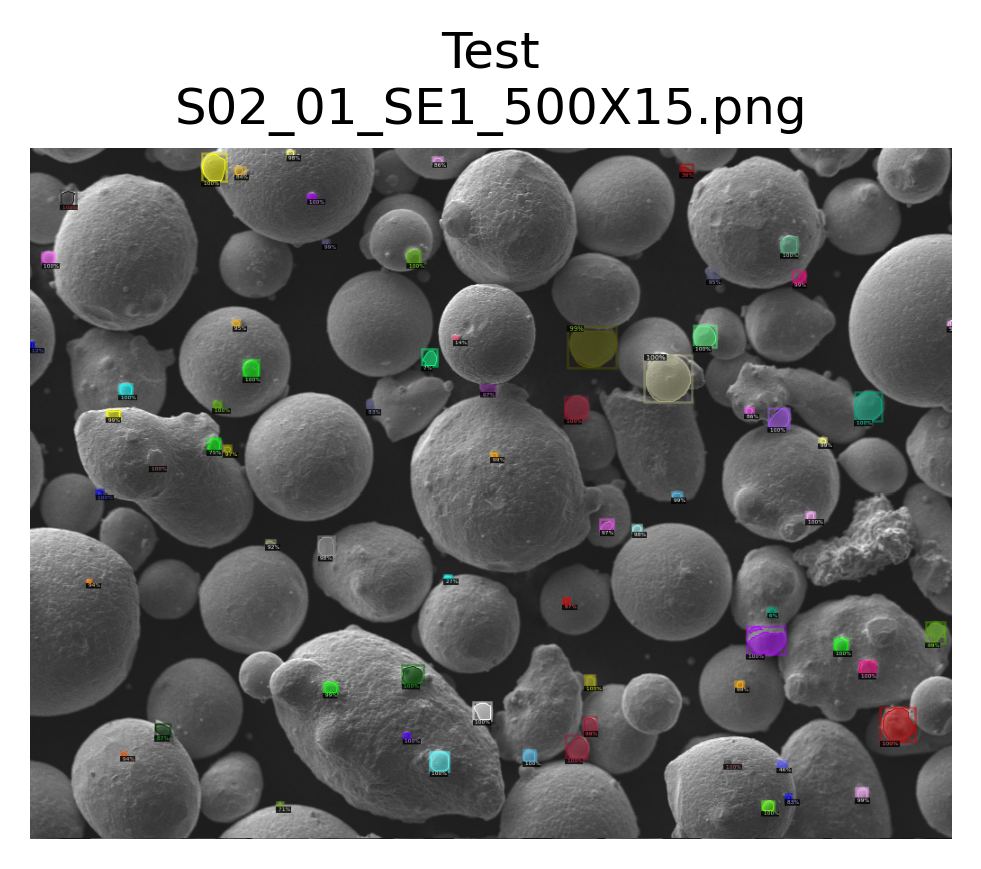

ddict info:
	path: Auto_annotate_images/S02_01_SE1_500X15.png
	num_instances: 70
Annotating: S08_01_SE1_1250X93


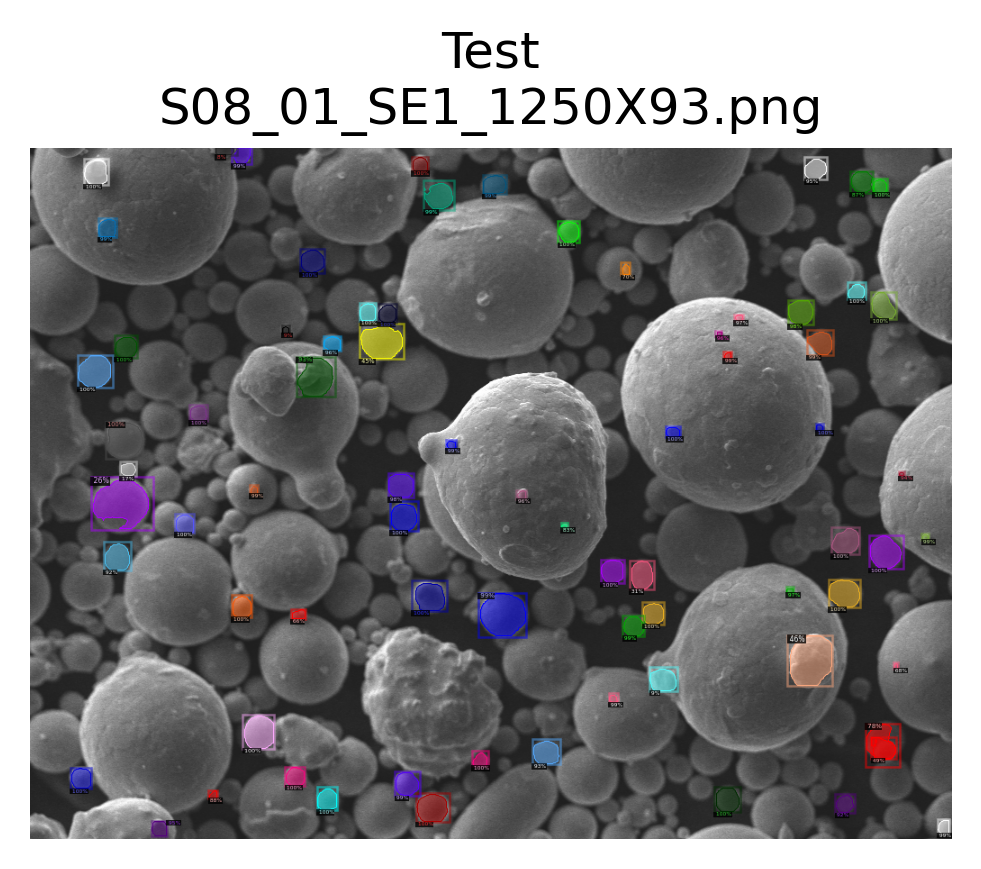

ddict info:
	path: Auto_annotate_images/S08_01_SE1_1250X93.png
	num_instances: 75
Annotating: S01_03_SE1_500X11


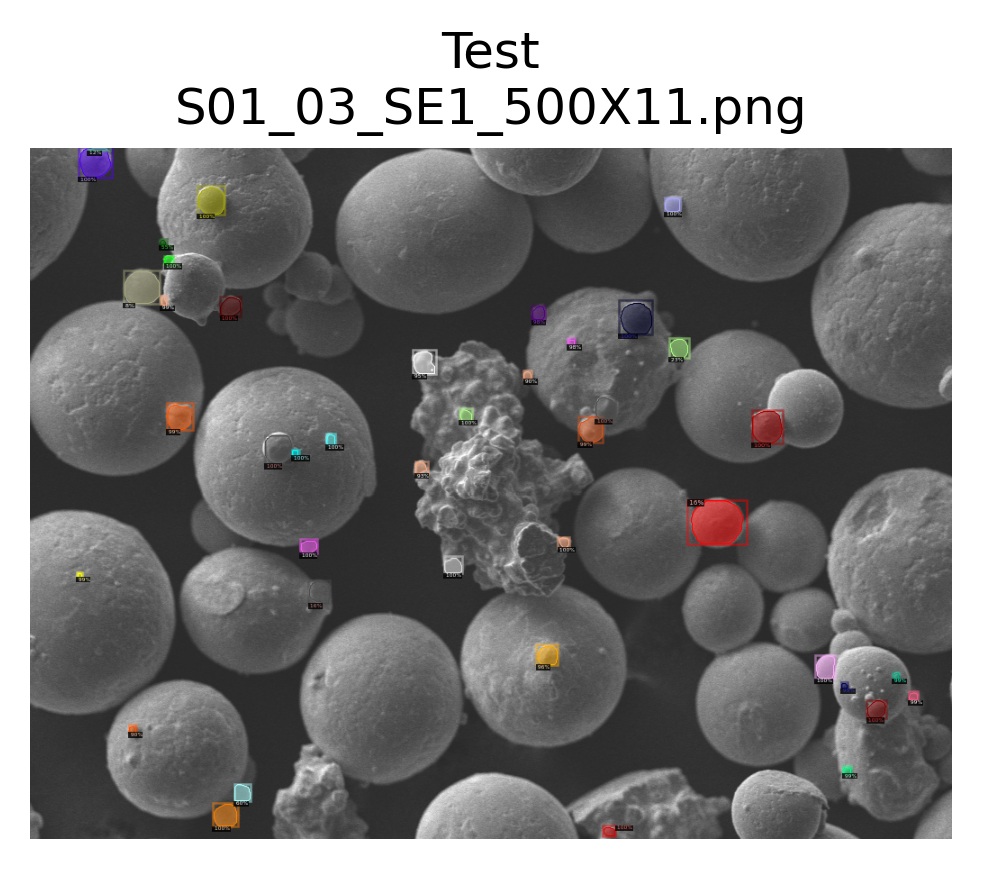

ddict info:
	path: Auto_annotate_images/S01_03_SE1_500X11.png
	num_instances: 41
Annotating: S02_02_SE1_500X19y


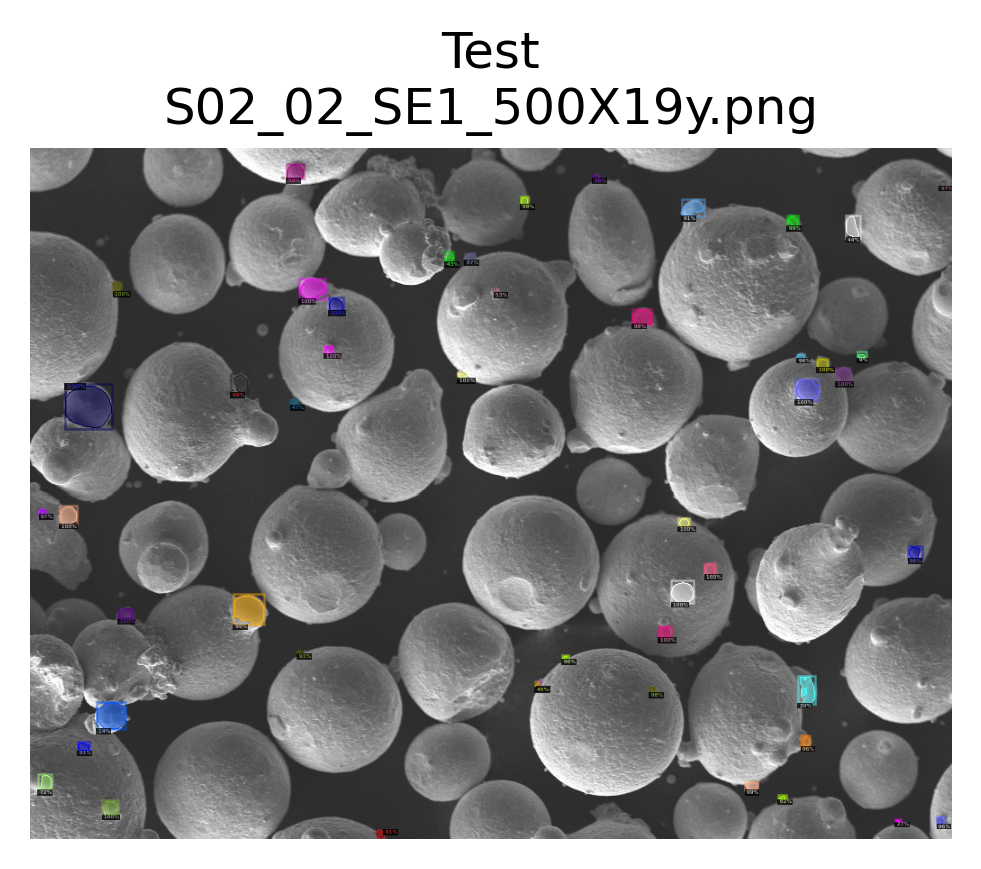

ddict info:
	path: Auto_annotate_images/S02_02_SE1_500X19y.png
	num_instances: 49
Annotating: S08_02_SE1_1000X99


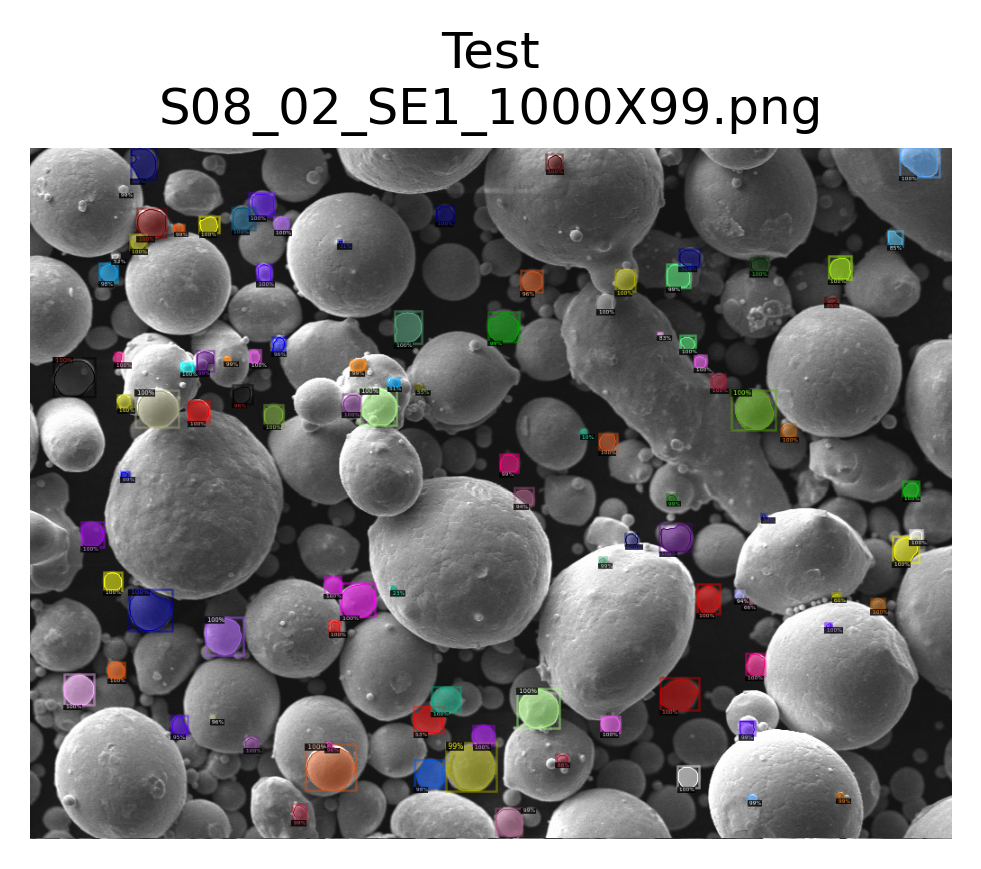

ddict info:
	path: Auto_annotate_images/S08_02_SE1_1000X99.png
	num_instances: 100
Annotating: S08_03_SE1_1000X03


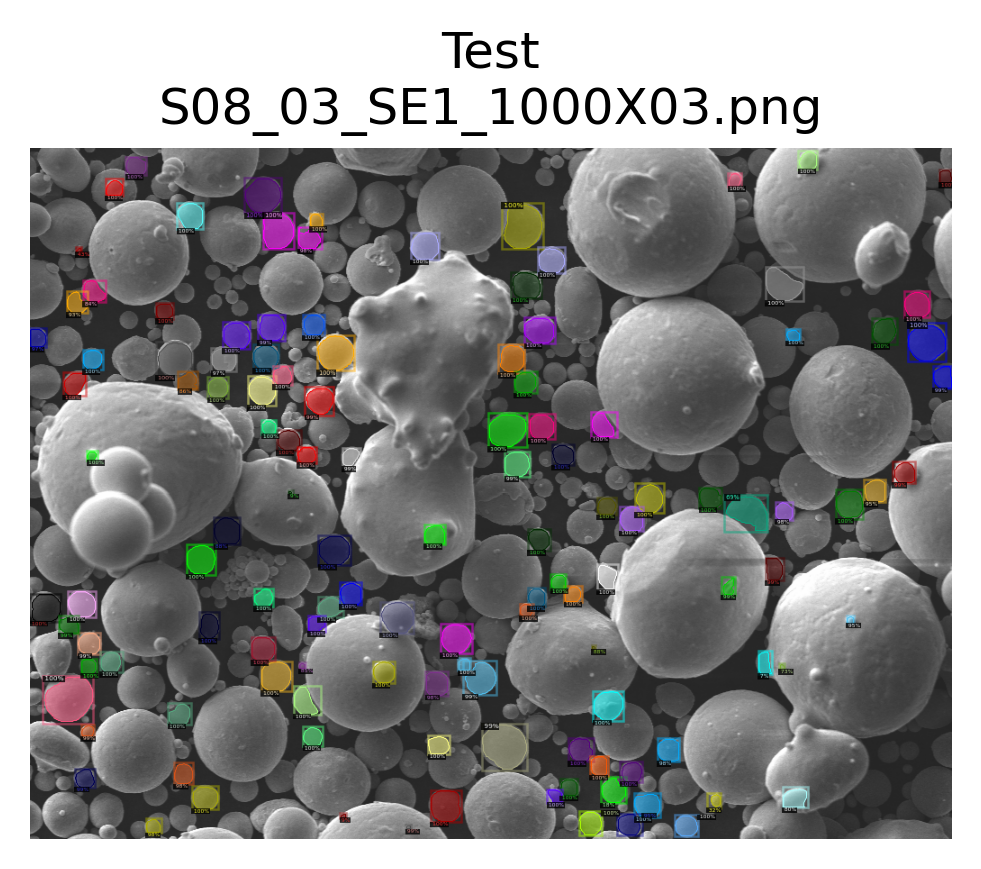

ddict info:
	path: Auto_annotate_images/S08_03_SE1_1000X03.png
	num_instances: 126
Annotating: annotations


AttributeError: 'NoneType' object has no attribute 'shape'

In [12]:
files = os.listdir('Auto_annotate_images')
img_names = []
for f in files:
    if f.split('.')[0] != '250x' and f.split('.')[0] != '500x':
        img_names.append(f.split('.')[0])
        
results = []
for f in img_names:
    print("Annotating: " + f)
    img_path = Path('Auto_annotate_images', f +'.png')
    img = cv2.imread(str(img_path))
    outs = predictor(img)
    data_utils.format_outputs(img_path, dataset='test', pred=outs)
    visualize.display_ddicts(ddict=outs,  # predictions to display
                                 outpath=None, dataset='Test',  # don't save fi$
                                 gt=False,  # specifies format as model predict$
                                 img_path=img_path, # path to image
                                 suppress_labels=True, #hides class images
                                 summary=True)  #hides the end print statement

# save to disk
with open(Path('Stage_results',f'{EXPERIMENT_NAME}-base_stage.pickle'), 'wb') as f:
    pickle.dump(results, f)